In [ ]:
function ClickConnect(){
    console.log("런타임 끊김 방지"); 
    document.querySelector("colab-toolbar-button#connect").click() 
}
setInterval(ClickConnect, 60 * 1000)

In [1]:

from google.colab import drive
drive.mount('/content/drive')

folder = '/content/drive/MyDrive/Colab Notebooks/1s'


Mounted at /content/drive


In [6]:
# !pip install pandas
# !pip install numpy
# !pip install seaborn
# !pip install matplotlib
# !pip install xgboost
# !pip install lightgbm
# !pip install sklearn
# !pip install graphviz

# 라이브러리 임포트
import os
import pandas as pd
import numpy as np

import seaborn as sns
import matplotlib
import matplotlib.pyplot as plt
%matplotlib inline

import xgboost
from xgboost import XGBClassifier
from lightgbm import LGBMClassifier

from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier, ExtraTreesClassifier, BaggingClassifier, GradientBoostingClassifier, VotingClassifier, StackingClassifier
from sklearn.linear_model import LogisticRegression, LinearRegression, Ridge, RidgeCV, RidgeClassifier
from sklearn.model_selection import train_test_split, RepeatedStratifiedKFold, GridSearchCV

import sklearn.metrics as metrics
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, roc_curve, auc, confusion_matrix

import warnings
warnings.filterwarnings('ignore')

import torch
import torch.nn as nn

In [ ]:
DEVICE = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')

# EDA

## 변수 설명
  - **int_rate** : 대출자에 부여된 이자율 (Interest rate of the loan the applicant received)
  - **annual_inc** : 연 소득 (annual income)
  - **dti** : 소득 대비 부채 비율 (Debt-to-income ratio)
  - **delinq_2yrs** : 지난 2년 간 체납 발생 횟수 (Delinquencies on lines of credit in the last 2 years)
  - **inq_last_6mths** : 지난 6개월 간 신용 조회 수 (Inquiries into the applicant's credit during the last 6 months)
  - **pub_rec** : 파산 횟수 (Number of bankruptcies listed in the public record)
  - **revol_bal** : 리볼빙 잔액 (Total credit revolving balance)
  - **total_acc** : 지금까지 소유했던 신용카드 개수 (num_total_cc_accounts : Total number of credit card accounts in the applicant's history)
  - **collections_12_mths_ex_med** : 의료부문을 제외한 지난 12개월 간 추심 발생 횟수 (num_collections_last_12m : Number of collections in the last 12 months. This excludes medical collections)
  - **acc_now_delinq** : 대출자가 체납 상태에 있지 않은 계좌의 수 (The number of accounts on which the borrower is now delinquent)
  - **tot_coll_amt** : 대출자에 대한 현재까지의 총 추심액 (total_collection_amount_ever : The total amount that the applicant has had against them in collections)
  - **tot_cur_bal** : 전 계좌의 현재 통합 잔고 (Total current balance of all accounts)
  - **chargeoff_within_12_mths** : 대출 부 신청인의 대출 신청 직전 12개월 간 세금 공제 횟수 (Number of charge-offs within last 12 months at time of application for the secondary applicant)
  - **delinq_amnt** : 체납 금액 (delinquency amount)
  - **tax_liens** : 세금 저당권의 수 (Number of tax liens)
  - **emp_length1 ~ 12** : 고용 연수 (Number of years in the job)
  - **home_ownership1 ~ 6** : 대출 신청자의 주거 소유 형태 (The ownership status of the applicant's residence)
  - **verification_status1 ~ 3** : 공동 소득 발생 여부 및 형태 (verification_income_joint : Type of verification of the joint income)
  - **purpose1 ~ 14** : 대출 목적 (The purpose of the loan)
  - **initial_list_status1 ~ 2** : 최초 대출 상태 (Initial listing status of the loan)
  - **mths_since_last_delinq1 ~ 11** : 마지막 체납이 지금으로부터 몇개월 전에 있었는지를 나타내는 변수 (Months since the last delinquency)
  
  - **funded_amnt** : 대출액 (Funded amount)
  - **funded_amnt_inv** : 사채 대출액 (Funded amount by investors)
  - **total_rec_late_fee** : 총 연체료 중 납부액 (Late fees received to date)
  - **term1** : 상환 기간 (The number of payments on the loan. Values are in months and can be either 36 or 60)
  - **open_acc** : 개설 개좌 수 (The number of open credit lines in the borrower's credit file)
  - **installment** : 대출 발생 시 월 상환액 (The monthly payment owed by the borrower if the loan originates)
  - **revol_util** : 리볼빙 한도 대비 리볼빙 사용 비율 (Revolving line utilization rate, or the amount of credit the borrower is using relative to all available revolving credit)
  - **out_prncp** : 대출액 중 원리금 잔액 (Remaining outstanding principal for total amount funded)
  - **out_prncp_inv** : 사채 대출액 중 원리금 잔액 (Remaining outstanding principal for total amount funded by investors)
  - **total_rec_int** : 이자 상환액 (Interest received to date)
  - **fico_range_low** : FICO(일종의 신용점수) 최저값 (The lower boundary range the borrower’s FICO at loan origination belongs to)
  - **fico_range_high** : FICO(일종의 신용점수) 최고값 (The upper boundary range the borrower’s FICO at loan origination belongs to)
  
  - **depvar** : 고객의 부도 여부 (dependent variable)

In [ ]:
# df = pd.read_csv('/content/drive/MyDrive/train.csv')
df = pd.read_csv(os.path.join(folder, 'train.csv'))
df.head(20)

,int_rate,annual_inc,dti,delinq_2yrs,inq_last_6mths,pub_rec,revol_bal,total_acc,collections_12_mths_ex_med,acc_now_delinq,tot_coll_amt,tot_cur_bal,chargeoff_within_12_mths,delinq_amnt,tax_liens,emp_length1,emp_length2,emp_length3,emp_length4,emp_length5,emp_length6,emp_length7,emp_length8,emp_length9,emp_length10,emp_length11,emp_length12,home_ownership1,home_ownership2,home_ownership3,home_ownership4,home_ownership5,home_ownership6,verification_status1,verification_status2,verification_status3,purpose1,purpose2,purpose3,purpose4,purpose5,purpose6,purpose7,purpose8,purpose9,purpose10,purpose11,purpose12,purpose13,purpose14,initial_list_status1,initial_list_status2,mths_since_last_delinq1,mths_since_last_delinq2,mths_since_last_delinq3,mths_since_last_delinq4,mths_since_last_delinq5,mths_since_last_delinq6,mths_since_last_delinq7,mths_since_last_delinq8,mths_since_last_delinq9,mths_since_last_delinq10,mths_since_last_delinq11,funded_amnt,funded_amnt_inv,total_rec_late_fee,term1,open_acc,installment,revol_util,out_prncp,out_prncp_inv,total_rec_int,fico_range_low,fico_range_high,depvar
0,0.0824,21000.00,29.19,0,1,0,3016,26,0,0,0,11773,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,1200,1200.0,0.0,1,18,37.74,0.076,0.0,0.0,157.94,765,769,0
1,0.1299,80000.00,4.82,0,1,1,5722,24,0,0,0,21875,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,8000,8000.0,0.0,1,8,269.52,0.447,0.0,0.0,1702.42,665,669,0
2,0.1299,38000.00,23.66,0,3,0,6511,18,0,0,0,31868,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,5000,5000.0,0.0,1,7,168.45,0.880,0.0,0.0,1066.64,670,674,0
3,0.1367,100000.00,16.27,4,2,0,6849,30,0,0,0,326049,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,15000,15000.0,0.0,1,12,510.27,0.457,0.0,0.0,1256.24,680,684,1
4,0.1269,30000.00,25.28,0,1,2,8197,12,0,0,2506,8840,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,10000,10000.0,0.0,1,8,335.45,0.416,0.0,0.0,871.04,660,664,1
5,0.1318,90000.00,3.48,7,0,0,2903,31,0,0,0,19548,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,7000,7000.0,0.0,1,7,236.47,0.854,0.0,0.0,1330.30,660,664,0
6,0.0791,60000.00,17.34,0,0,0,20399,35,0,0,0,117320,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,20000,20000.0,0.0,1,18,625.90,0.369,0.0,0.0,2567.44,750,754,0
7,0.0975,79600.00,15.97,3,0,1,6481,17,0,0,0,18757,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,23800,23800.0,0.0,1,7,765.17,0.745,0.0,0.0,3006.76,680,684,0
8,0.0789,150000.00,7.36,1,0,0,15827,38,0,0,543,367504,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,16000,16000.0,0.0,1,19,500.58,0.334,0.0,0.0,1286.38,665,669,0
9,0.0999,95000.00,25.78,0,1,0,17870,37,0,0,0,273776,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,8000,8000.0,0.0,1,24,258.10,0.764,0.0,0.0,796.59,665,669,0


# EDA

In [ ]:
df.info()

In [ ]:
df.describe()

,int_rate,annual_inc,dti,delinq_2yrs,inq_last_6mths,pub_rec,revol_bal,total_acc,collections_12_mths_ex_med,acc_now_delinq,tot_coll_amt,tot_cur_bal,chargeoff_within_12_mths,delinq_amnt,tax_liens,emp_length1,emp_length2,emp_length3,emp_length4,emp_length5,emp_length6,emp_length7,emp_length8,emp_length9,emp_length10,emp_length11,emp_length12,home_ownership1,home_ownership2,home_ownership3,home_ownership4,home_ownership5,home_ownership6,verification_status1,verification_status2,verification_status3,purpose1,purpose2,purpose3,purpose4,purpose5,purpose6,purpose7,purpose8,purpose9,purpose10,purpose11,purpose12,purpose13,purpose14,initial_list_status1,initial_list_status2,mths_since_last_delinq1,mths_since_last_delinq2,mths_since_last_delinq3,mths_since_last_delinq4,mths_since_last_delinq5,mths_since_last_delinq6,mths_since_last_delinq7,mths_since_last_delinq8,mths_since_last_delinq9,mths_since_last_delinq10,mths_since_last_delinq11,funded_amnt,funded_amnt_inv,total_rec_late_fee,term1,open_acc,installment,revol_util,out_prncp,out_prncp_inv,total_rec_int,fico_range_low,fico_range_high,depvar
count,100000.000000,1.000000e+05,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,1.000000e+05,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.00000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.0,100000.000000,100000.000000,100000.000000,100000.00000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,1.000000e+05,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000
mean,0.130833,7.436061e+04,18.514508,0.343700,0.668880,0.235720,16090.202820,24.675910,0.018810,0.005800,250.588120,1.305281e+05,0.009630,19.288330,0.063820,0.065400,0.326240,0.089410,0.08058,0.059480,0.060710,0.046640,0.045320,0.045690,0.038570,0.075550,0.066410,0.000330,0.466120,0.000070,0.000050,0.110880,0.422550,0.321800,0.390200,0.288000,0.009620,0.226720,0.582810,0.0,0.060400,0.004250,0.019830,0.01101,0.007310,0.058200,0.000650,0.011250,0.007070,0.000880,0.434430,0.565570,0.489320,0.052360,0.060090,0.045700,0.050750,0.048560,0.051340,0.053430,0.048960,0.050030,0.049460,13735.317750,13729.341073,2.448885e+00,0.855920,11.620700,434.077648,0.537233,0.253327,0.253259,2491.282802,692.630550,696.630660,0.325690
std,0.044773,7.467409e+04,8.413049,0.905007,0.952044,0.661468,21569.939271,11.883834,0.150321,0.083585,2042.770881,1.503326e+05,0.110079,893.304366,0.468027,0.247232,0.468839,0.285336,0.27219,0.236522,0.238799,0.210868,0.208006,0.208813,0.192569,0.264278,0.248999,0.018163,0.498853,0.008366,0.007071,0.313985,0.493968,0.467169,0.487797,0.452833,0.097609,0.418712,0.493097,0.0,0.238228,0.065054,0.139417,0.10435,0.085186,0.234122,0.025487,0.105468,0.083786,0.029652,0.495684,0.495684,0.499888,0.222753,0.237655,0.208835,0.219488,0.214947,0.220691,0.224891,0.215786,0.218008,0.216828,8464.825314,8461.694483,1.489496e+01,0.351173,5.458774,265.921746,0.239373,18.053290,18.051746,2706.262200,29.668017,29.668584,0.468634
min,0.053200,5.360000e+03,0.000000,0.000000,0.000000,0.000000,0.000000,2.000000,0.000000,0.000000,0.000000,0.000000e+00,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.00000,

In [ ]:
# 결측치 확인
pd.DataFrame(df.isnull().sum()).rename(columns={0:'Non-Null Count'}).T

,int_rate,annual_inc,dti,delinq_2yrs,inq_last_6mths,pub_rec,revol_bal,total_acc,collections_12_mths_ex_med,acc_now_delinq,tot_coll_amt,tot_cur_bal,chargeoff_within_12_mths,delinq_amnt,tax_liens,emp_length1,emp_length2,emp_length3,emp_length4,emp_length5,emp_length6,emp_length7,emp_length8,emp_length9,emp_length10,emp_length11,emp_length12,home_ownership1,home_ownership2,home_ownership3,home_ownership4,home_ownership5,home_ownership6,verification_status1,verification_status2,verification_status3,purpose1,purpose2,purpose3,purpose4,purpose5,purpose6,purpose7,purpose8,purpose9,purpose10,purpose11,purpose12,purpose13,purpose14,initial_list_status1,initial_list_status2,mths_since_last_delinq1,mths_since_last_delinq2,mths_since_last_delinq3,mths_since_last_delinq4,mths_since_last_delinq5,mths_since_last_delinq6,mths_since_last_delinq7,mths_since_last_delinq8,mths_since_last_delinq9,mths_since_last_delinq10,mths_since_last_delinq11,funded_amnt,funded_amnt_inv,total_rec_late_fee,term1,open_acc,installment,revol_util,out_prncp,out_prncp_inv,total_rec_int,fico_range_low,fico_range_high,depvar
Non-Null Count,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [ ]:
# 라벨(depvar) 비율 확인
print('y=1 ratio :', df.depvar.sum()/len(df))

y=1 ratio : 0.32569


#데이터 시각화

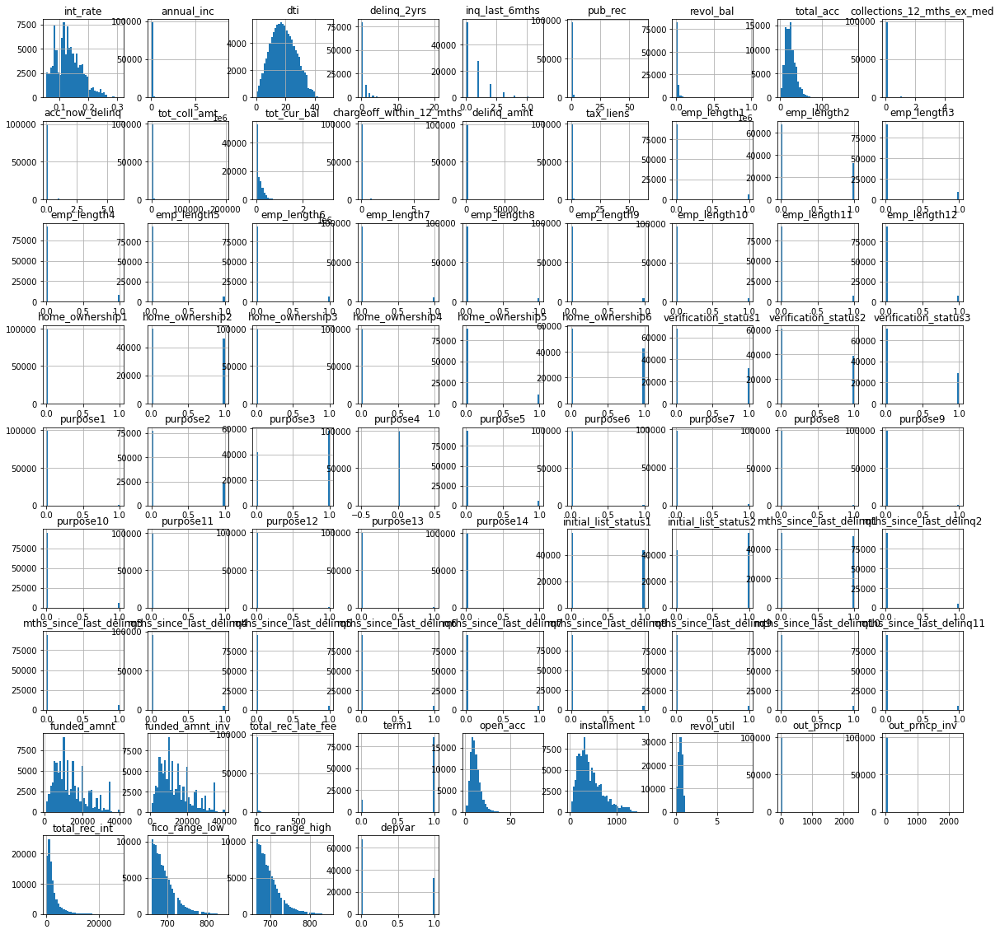

In [ ]:
df.hist(bins=40 , figsize=(20,20)) #Pandas Hist function
plt.show()

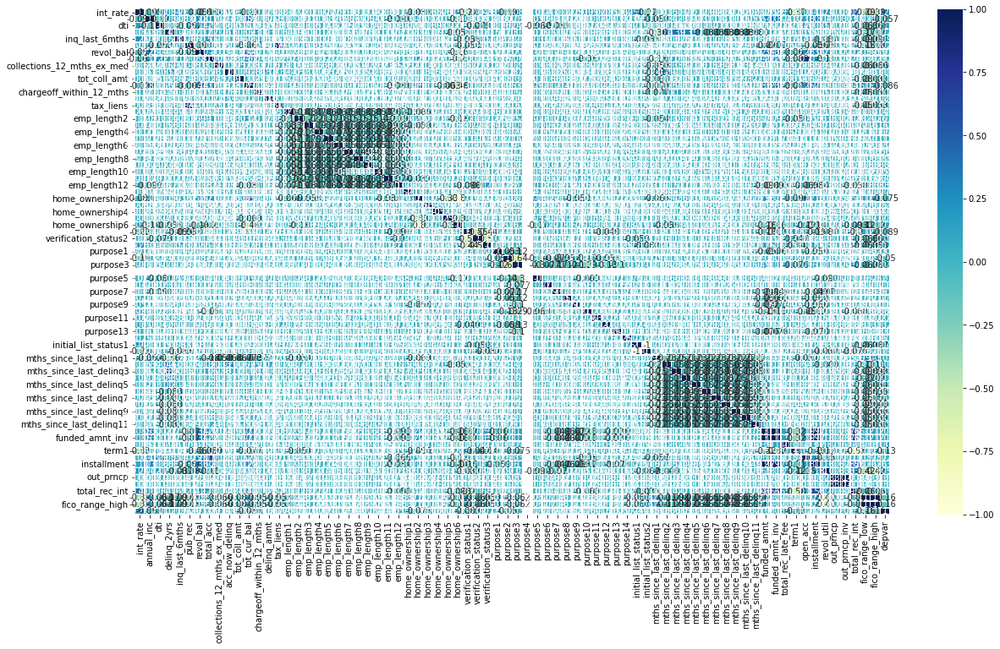

In [ ]:
corr = df.corr()
plt.figure(figsize=(20,11))
ax = sns.heatmap(corr,cmap="YlGnBu", linewidths=.5, annot=True )
plt.yticks(rotation=0)
plt.show()

In [ ]:
import seaborn as sns
df_see = df.drop()
sns.set(style="white")

g = sns.PairGrid(df, diag_sharey=False)
g.map_lower(sns.kdeplot)
g.map_diag(sns.kdeplot, lw=3)

g.map_upper(sns.regplot)

display(g.fig)

KeyboardInterrupt: ignored

Error in callback <function install_repl_displayhook.<locals>.post_execute at 0x7f2028683050> (for post_execute):


KeyboardInterrupt: ignored

# Train Valid Split

In [ ]:
X = df.drop('depvar', axis=1)
y = df['depvar']

In [ ]:
# data를 training set과 validation set으로 나누기
X_train, X_valid, y_train, y_valid = train_test_split(X, y, test_size=0.2)
# X_test, X_valid, y_test, y_valid = train_test_split(X_valid, y_valid, test_size=0.5)


In [ ]:
# training set과 validation set의 데이터 수 확인
print('training set length :', len(X_train))
print('validation set length :', len(X_valid))
# print('test set length :', len(X_test))

training set length : 80000
validation set length : 20000


In [ ]:
# validation set의 라벨 비율 확인
print(y_valid.sum()/len(y_valid))
# print(y_test.sum()/len(y_test))


0.32415


In [ ]:
# 평가 함수 정의
def get_clf_eval(y_actual, y_pred):
    accuracy = accuracy_score(y_actual, y_pred)
    precision = precision_score(y_actual, y_pred)
    recall = recall_score(y_actual, y_pred)
    AUC = roc_auc_score(y_actual, y_pred)
    F1 = f1_score(y_actual, y_pred)
    print('\n정확도accuracy: {:.4f}'.format(accuracy))
    print('정밀도precision: {:.4f}'.format(precision))
    print('재현율recall: {:.4f}'.format(recall))
    print('AUC: {:.4f}'.format(AUC))
    print('F1: {:.4f}'.format(F1))
    sns.heatmap(confusion_matrix(y_actual, y_pred), annot=True, fmt='d', cmap='YlGnBu')
    return {'정확도accuracy' : accuracy, '정밀도precision': precision, '재현율recall': recall, 'AUC': AUC, 'F1': F1}

# Single Model(XGBoost)
## XGBClassifier의 하이퍼 파라미터 설명
- **LINK** : https://xgboost.readthedocs.io/en/stable/python/python_api.html#xgboost.XGBClassifier
- **max_depth=3** : 디시전 트리의 최대 깊이
- **learning_rate=0.1** : 0과 1 사이의 값을 가지는 부스팅에 대한 학습률(eta). 매 부스팅 단계 이후 새로이 추가된 가중치는 이 파라미터로 조정된다. 이 값이 낮을수록 보수적이며, 수렴에 필요한 더 많은 디시전 트리가 필요하다.
- **n_estimators=100** : 라운드의 횟수 또는 부스팅된 디시전 트리의 개수
- **silent=True** : 부스팅의 수행 동안 메시지를 출력할지에 대한 여부
- **objective="reg:linear"** : 모델이 학습할 작업의 분류, 미리 정의된 작업은 문자열로 지정이 가능하지만, 그렇지 않은 경우 콜러블callable을 만들어서 지정할 수도 있다.
- **booster="gbtree"** : 'gbtree', 'gblinear', 'dart'일 수 있다. 'dart'는 드롭아웃(dropout)이라는 특성을 추가한다(과적합 방지를 위해 무작위로 디시전 트리를 선택해 제거(드롭)한다). 'gblinear'는 정규화된 선형 모델을 만든다(디시전 트리가 아니라 라소 회귀와 유사하다).
- **nthread=None** : 더 이상 사용되지 않는다.
- **n_jobs** : 사용할 스레드의 개수
- **gamma=0** : 노드 분할에 필요한 최소 손실 감소
- **min_child_weight=1** : 자식 노드 생성에 필요한 헤시안(hessian) 합의 최솟값
- **max_delta_step=0** : 보다 보수적으로 갱신을 수행하도록 만드는 값. 불균형 범주의 데이터셋에 대해서는 1부터 10까지의 값으로 설정한다.
- **subsample=1** : 부스팅에 사용할 샘플의 비율
- **colsample_bytree=1** : 부스팅에 사용할 특징 열의 비율
- **colsample_bylevel=1** : 각 디시전 트리의 수준별 사용할 특징 열의 비율
- **colsample_bynode=1** : 각 디시전 트리의 노드별 사용할 특징 열의 비율
- **reg_alpha=0** : L1 정규화(가중치의 평균). 이 값이 클수록 보수적이게 된다.
- **reg_lambda=1** : L2 정규화(가중치의 제곱근). 이 값이 클수록 보수적이게 된다.
- **base_score=.5** : 초기 편향치(bias)
- **seed=None** : 더 이상 사용되지 않는다.
- **random_state=0** : 난수 생성 시드
- **missing=None** : 누락된 데이터가 해석될 값. None은 np.nan을 의미한다.
- **importance_type='gain'** : 특징 중요도의 유형. 'gain', 'weight', 'cover', 'total_gain', 'total_cover'로 설정될 수 있다.

In [ ]:
# 하이퍼 파라미터 튜닝
xgb_clf = xgboost.XGBClassifier()

param_grid = {'max_depth':[5],
              'n_estimators': list(range(290,300,3))}

cv=RepeatedStratifiedKFold(n_splits=5, n_repeats=2)

grid_search = GridSearchCV(estimator=xgb_clf,
                           param_grid=param_grid, 
                           n_jobs=-1,
                           cv=cv,
                           scoring='accuracy', 
                           error_score=0) 

results=grid_search.fit(X_train, y_train)

results.best_params_

{'max_depth': 5, 'n_estimators': 299}

In [ ]:
# best parameter를 사용하여 prediction 수행
xgb_clf = xgboost.XGBClassifier(max_depth = results.best_params_['max_depth'],
                                n_estimators = results.best_params_['n_estimators'],
                                eval_metric='mlogloss')

In [ ]:
xgb_clf = xgboost.XGBClassifier(max_depth = 5,
                                n_estimators = 299,
                                eval_metric='mlogloss')

In [ ]:


xgb_clf.fit(X_train, y_train)

y_pred_xgb = xgb_clf.predict(X_valid)

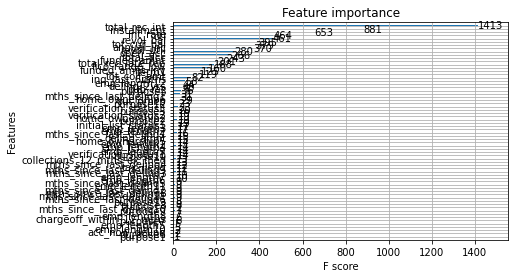

In [ ]:
import xgboost as xgb

xgb.plot_importance(xgb_clf)

In [ ]:
# y_valid가 0 또는 1일 확률 출력
y_pred_prob = xgb_clf.predict_proba(X_valid)

print(len(y_pred_prob))
y_pred_prob

20000


array([[0.8749127 , 0.12508734],
       [0.22817653, 0.77182347],
       [0.7755881 , 0.22441189],
       ...,
       [0.6803547 , 0.31964526],
       [0.9558677 , 0.04413228],
       [0.8032835 , 0.19671647]], dtype=float32)

In [ ]:
# y_valid가 1일 확률 출력
y_pred_prob[:,1]

array([0.05295987, 0.1549587 , 0.05818719, ..., 0.49324298, 0.6826446 ,
       0.27548695], dtype=float32)

In [ ]:
# y_valid 예측값 출력
# y_pred_prob[:,1]이 0.5(threshold)보다 큰 경우 1의 예측값을 return한다

print(len(y_pred_xgb))
y_pred_xgb

20000


array([0, 0, 0, ..., 0, 1, 0])

In [ ]:
# 1로 예측된 y_valid 갯수 및 비율 출력
print(y_pred_xgb.sum())
print(y_pred_xgb.sum()/len(y_pred_xgb))

3391
0.16955



정확도accuracy: 0.7557
정밀도precision: 0.6721
재현율recall: 0.4713
AUC: 0.6810
F1: 0.5540


{'AUC': 0.68102750141996,
 'F1': 0.5540343190945601,
 '재현율recall': 0.47127329192546585,
 '정밀도precision': 0.6720549158547388,
 '정확도accuracy': 0.7557}

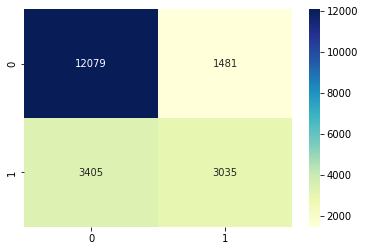

In [ ]:
# xgboost 성능 확인
get_clf_eval(y_valid, y_pred_xgb)


정확도accuracy: 0.7500
정밀도precision: 0.6134
재현율recall: 0.6050
AUC: 0.7119
F1: 0.6091


{'AUC': 0.7119240000732883,
 'F1': 0.6091307066916822,
 '재현율recall': 0.6049689440993788,
 '정밀도precision': 0.6133501259445844,
 '정확도accuracy': 0.75}

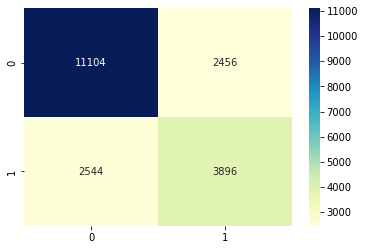

In [ ]:
# threshold 변경 및 성능 확인
get_clf_eval(y_valid, y_pred_prob[:,1]>0.4)

#cockpit   
https://cockpit.readthedocs.io/en/latest/examples/01_basic_fmnist.html

In [ ]:
# !pip install cockpit-for-pytorch


In [ ]:
# from cockpit import Cockpit, CockpitPlotter
# from cockpit.utils.configuration import configuration


# # Create Cockpit and a plotter
# cockpit = Cockpit(model.parameters(), quantities=configuration("full"))
# plotter = CockpitPlotter()

# TabNet    
https://wsshin.tistory.com/5   
https://dreamquark-ai.github.io/tabnet/generated_docs/README.html#tabnet-attentive-interpretable-tabular-learning   
https://github.com/dreamquark-ai/tabnet

In [ ]:
!pip install pytorch-tabnet

In [ ]:
import os
import numpy as np
import pandas as pd
from sklearn.metrics import roc_auc_score
from sklearn.preprocessing import LabelEncoder
from matplotlib import pyplot as plt

import torch
import torch.nn as nn
from pytorch_tabnet.tab_model import TabNetClassifier, TabNetRegressor


In [ ]:
y_train

43311    1
83224    0
90751    0
9219     0
9755     1
        ..
70420    0
84334    1
58663    0
86265    1
54083    0
Name: depvar, Length: 80000, dtype: int64

In [ ]:
X_train

,int_rate,annual_inc,dti,delinq_2yrs,inq_last_6mths,pub_rec,revol_bal,total_acc,collections_12_mths_ex_med,acc_now_delinq,tot_coll_amt,tot_cur_bal,chargeoff_within_12_mths,delinq_amnt,tax_liens,emp_length1,emp_length2,emp_length3,emp_length4,emp_length5,emp_length6,emp_length7,emp_length8,emp_length9,emp_length10,emp_length11,emp_length12,home_ownership1,home_ownership2,home_ownership3,home_ownership4,home_ownership5,home_ownership6,verification_status1,verification_status2,verification_status3,purpose1,purpose2,purpose3,purpose4,purpose5,purpose6,purpose7,purpose8,purpose9,purpose10,purpose11,purpose12,purpose13,purpose14,initial_list_status1,initial_list_status2,mths_since_last_delinq1,mths_since_last_delinq2,mths_since_last_delinq3,mths_since_last_delinq4,mths_since_last_delinq5,mths_since_last_delinq6,mths_since_last_delinq7,mths_since_last_delinq8,mths_since_last_delinq9,mths_since_last_delinq10,mths_since_last_delinq11,funded_amnt,funded_amnt_inv,total_rec_late_fee,term1,open_acc,installment,revol_util,out_prncp,out_prncp_inv,total_rec_int,fico_range_low,fico_range_high
43311,0.2499,83688.0,4.45,0,3,0,7862,25,0,0,0,18566,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,11925,11925.0,0.0,0,13,349.95,0.936,0.0,0.0,3234.06,670,674
83224,0.1999,101800.0,9.60,1,1,2,3914,20,0,0,0,32618,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,12150,12150.0,0.0,0,13,321.84,0.311,0.0,0.0,6724.50,715,719
90751,0.1757,94000.0,6.24,0,1,0,18628,16,0,0,0,273161,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,25000,25000.0,0.0,1,6,898.43,0.763,0.0,0.0,7294.50,675,679
9219,0.1580,108000.0,29.26,3,0,0,36091,42,0,0,0,265688,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,18000,18000.0,0.0,0,12,435.82,0.940,0.0,0.0,2043.70,685,689
9755,0.2290,80000.0,21.04,0,0,0,58520,33,0,0,0,335362,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,35000,35000.0,0.0,0,22,984.66,0.740,0.0,0.0,6392.85,665,669
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
70420,0.1144,45000.0,4.65,0,0,0,4903,19,0,0,0,4903,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,6000,6000.0,0.0,1,3,197.69,0.584,0.0,0.0,512.63,705,709
84334,0.1399,33000.0,27.20,0,0,0,3777,12,0,0,0,23789,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,11075,11075.0,0.0,1,12,378.47,0.250,0.0,0.0,1341.26,715,719
58663,0.0890,128000.0,16.63,1,1,0,40371,48,0,0,0,267721,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,14000,13975.0,0.0,1,18,444.55,0.697,0.0,0.0,401.76,705,709
86265,0.1777,104000.0,13.44,0,1,0,9233,12,0,0,0,38738,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,10000,10000.0,0.0,1,10,360.38,0.933,0.0,0.0,1333.06,660,664


In [ ]:
from sklearn.preprocessing import LabelEncoder

nunique = X_train.nunique()
categorical_columns = []
categorical_dims =  {}
categorical_dims_all = {}
for col in X_train.columns:
    l_enc = LabelEncoder()
    X_train[col] = l_enc.fit_transform(X_train[col].values)        
    categorical_columns.append(col)
    categorical_dims_all[col] = len(l_enc.classes_)
categorical_columns = []
for col in X_train.columns:
    if nunique[col] < 20:
        categorical_columns.append(col)
        categorical_dims[col] = len(l_enc.classes_)

In [ ]:
print(X_train.columns)
print(len(X_train.columns))

Index(['int_rate', 'annual_inc', 'dti', 'delinq_2yrs', 'inq_last_6mths',
       'pub_rec', 'revol_bal', 'total_acc', 'collections_12_mths_ex_med',
       'acc_now_delinq', 'tot_coll_amt', 'tot_cur_bal',
       'chargeoff_within_12_mths', 'delinq_amnt', 'tax_liens', 'emp_length1',
       'emp_length2', 'emp_length3', 'emp_length4', 'emp_length5',
       'emp_length6', 'emp_length7', 'emp_length8', 'emp_length9',
       'emp_length10', 'emp_length11', 'emp_length12', 'home_ownership1',
       'home_ownership2', 'home_ownership3', 'home_ownership4',
       'home_ownership5', 'home_ownership6', 'verification_status1',
       'verification_status2', 'verification_status3', 'purpose1', 'purpose2',
       'purpose3', 'purpose4', 'purpose5', 'purpose6', 'purpose7', 'purpose8',
       'purpose9', 'purpose10', 'purpose11', 'purpose12', 'purpose13',
       'purpose14', 'initial_list_status1', 'initial_list_status2',
       'mths_since_last_delinq1', 'mths_since_last_delinq2',
       'mths_since_l

In [ ]:
print(categorical_dims_all)
print(len(categorical_dims_all))

{'int_rate': 256, 'annual_inc': 7495, 'dti': 4113, 'delinq_2yrs': 19, 'inq_last_6mths': 7, 'pub_rec': 22, 'revol_bal': 32777, 'total_acc': 103, 'collections_12_mths_ex_med': 6, 'acc_now_delinq': 6, 'tot_coll_amt': 3414, 'tot_cur_bal': 67033, 'chargeoff_within_12_mths': 7, 'delinq_amnt': 271, 'tax_liens': 21, 'emp_length1': 2, 'emp_length2': 2, 'emp_length3': 2, 'emp_length4': 2, 'emp_length5': 2, 'emp_length6': 2, 'emp_length7': 2, 'emp_length8': 2, 'emp_length9': 2, 'emp_length10': 2, 'emp_length11': 2, 'emp_length12': 2, 'home_ownership1': 2, 'home_ownership2': 2, 'home_ownership3': 2, 'home_ownership4': 2, 'home_ownership5': 2, 'home_ownership6': 2, 'verification_status1': 2, 'verification_status2': 2, 'verification_status3': 2, 'purpose1': 2, 'purpose2': 2, 'purpose3': 2, 'purpose4': 1, 'purpose5': 2, 'purpose6': 2, 'purpose7': 2, 'purpose8': 2, 'purpose9': 2, 'purpose10': 2, 'purpose11': 2, 'purpose12': 2, 'purpose13': 2, 'purpose14': 2, 'initial_list_status1': 2, 'initial_list_st

In [ ]:
print(categorical_columns)
print(len(categorical_columns))

['delinq_2yrs', 'inq_last_6mths', 'collections_12_mths_ex_med', 'acc_now_delinq', 'chargeoff_within_12_mths', 'emp_length1', 'emp_length2', 'emp_length3', 'emp_length4', 'emp_length5', 'emp_length6', 'emp_length7', 'emp_length8', 'emp_length9', 'emp_length10', 'emp_length11', 'emp_length12', 'home_ownership1', 'home_ownership2', 'home_ownership3', 'home_ownership4', 'home_ownership5', 'home_ownership6', 'verification_status1', 'verification_status2', 'verification_status3', 'purpose1', 'purpose2', 'purpose3', 'purpose4', 'purpose5', 'purpose6', 'purpose7', 'purpose8', 'purpose9', 'purpose10', 'purpose11', 'purpose12', 'purpose13', 'purpose14', 'initial_list_status1', 'initial_list_status2', 'mths_since_last_delinq1', 'mths_since_last_delinq2', 'mths_since_last_delinq3', 'mths_since_last_delinq4', 'mths_since_last_delinq5', 'mths_since_last_delinq6', 'mths_since_last_delinq7', 'mths_since_last_delinq8', 'mths_since_last_delinq9', 'mths_since_last_delinq10', 'mths_since_last_delinq11', '

In [ ]:
print(categorical_dims)
print(len(categorical_dims))

{'delinq_2yrs': 38, 'inq_last_6mths': 38, 'collections_12_mths_ex_med': 38, 'acc_now_delinq': 38, 'chargeoff_within_12_mths': 38, 'emp_length1': 38, 'emp_length2': 38, 'emp_length3': 38, 'emp_length4': 38, 'emp_length5': 38, 'emp_length6': 38, 'emp_length7': 38, 'emp_length8': 38, 'emp_length9': 38, 'emp_length10': 38, 'emp_length11': 38, 'emp_length12': 38, 'home_ownership1': 38, 'home_ownership2': 38, 'home_ownership3': 38, 'home_ownership4': 38, 'home_ownership5': 38, 'home_ownership6': 38, 'verification_status1': 38, 'verification_status2': 38, 'verification_status3': 38, 'purpose1': 38, 'purpose2': 38, 'purpose3': 38, 'purpose4': 38, 'purpose5': 38, 'purpose6': 38, 'purpose7': 38, 'purpose8': 38, 'purpose9': 38, 'purpose10': 38, 'purpose11': 38, 'purpose12': 38, 'purpose13': 38, 'purpose14': 38, 'initial_list_status1': 38, 'initial_list_status2': 38, 'mths_since_last_delinq1': 38, 'mths_since_last_delinq2': 38, 'mths_since_last_delinq3': 38, 'mths_since_last_delinq4': 38, 'mths_si

In [ ]:
features = [ col for col in X_train.columns ]
cat_idxs = [ i for i, f in enumerate(features) if f in categorical_columns]
cat_dims = [ categorical_dims[f] for i, f in enumerate(features) if f in categorical_columns]

In [ ]:
cat_idxs

In [ ]:
cat_dims

In [ ]:
clf

TabNetClassifier(n_d=8, n_a=8, n_steps=3, gamma=1.3, cat_idxs=[15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 66], cat_dims=[2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2], cat_emb_dim=10, n_independent=2, n_shared=2, epsilon=1e-15, momentum=0.02, lambda_sparse=0.001, seed=0, clip_value=1, verbose=1, optimizer_fn=<class 'torch.optim.adam.Adam'>, optimizer_params={'lr': 0.01}, scheduler_fn=<class 'torch.optim.lr_scheduler.StepLR'>, scheduler_params={'step_size': 50, 'gamma': 0.9}, mask_type='sparsemax', input_dim=None, output_dim=None, device_name='auto')

In [ ]:
X_valid


In [ ]:
X_train

In [ ]:
(X_train, y_train)

(       int_rate  annual_inc  ...  fico_range_low  fico_range_high
 43860       110        4038  ...               6                6
 35751       136        4552  ...               0                0
 61467        59        2155  ...               9                9
 34618        63        5590  ...               3                3
 1605        126         757  ...               7                7
 ...         ...         ...  ...             ...              ...
 25228       164        5017  ...               5                5
 51319         6        2991  ...              16               16
 81351        36        6796  ...               3                3
 21441       107        1013  ...               2                2
 27677        52        1852  ...               5                5
 
 [80000 rows x 75 columns], 43860    0
 35751    0
 61467    0
 34618    1
 1605     0
         ..
 25228    1
 51319    0
 81351    0
 21441    0
 27677    1
 Name: depvar, Length: 80000, dtype

Device used : cpu
epoch 0  | loss: 0.72555 | train_balanced_accuracy: 0.50809 | valid_balanced_accuracy: 0.49749 |  0:00:41s
epoch 1  | loss: 0.67935 | train_balanced_accuracy: 0.62841 | valid_balanced_accuracy: 0.50096 |  0:01:22s
epoch 2  | loss: 0.64487 | train_balanced_accuracy: 0.62747 | valid_balanced_accuracy: 0.5034  |  0:02:01s
epoch 3  | loss: 0.63885 | train_balanced_accuracy: 0.62701 | valid_balanced_accuracy: 0.50206 |  0:02:41s
epoch 4  | loss: 0.63379 | train_balanced_accuracy: 0.63802 | valid_balanced_accuracy: 0.50046 |  0:03:21s
epoch 5  | loss: 0.63332 | train_balanced_accuracy: 0.64269 | valid_balanced_accuracy: 0.50338 |  0:03:59s
epoch 6  | loss: 0.6299  | train_balanced_accuracy: 0.6414  | valid_balanced_accuracy: 0.50863 |  0:04:38s
epoch 7  | loss: 0.62772 | train_balanced_accuracy: 0.63849 | valid_balanced_accuracy: 0.51105 |  0:05:16s
epoch 8  | loss: 0.62539 | train_balanced_accuracy: 0.6313  | valid_balanced_accuracy: 0.50556 |  0:05:54s
epoch 9  | loss: 0.

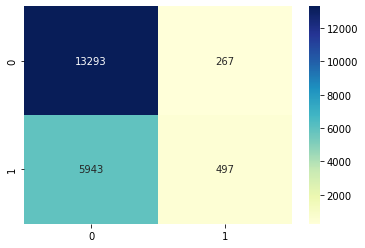

In [ ]:
# final

tabnet_clf = TabNetClassifier(cat_idxs=cat_idxs,
                        cat_dims=cat_dims,
                        cat_emb_dim=1,
                        optimizer_fn=torch.optim.Adam,
                        optimizer_params=dict(lr=1e-2),
                        scheduler_params={"step_size":50,
                                            "gamma":0.9},
                        scheduler_fn=torch.optim.lr_scheduler.StepLR,
                        mask_type='sparsemax' # "sparsemax", entmax
                        )
        
max_epochs = 20
tabnet_clf.fit(
    X_train=X_train.values, y_train=y_train.values,
    eval_set=[(X_train.values, y_train.values), (X_valid.values, y_valid.values)],
    eval_name=['train', 'valid'],
    eval_metric=['balanced_accuracy'],
    max_epochs=max_epochs, 
    patience=50,
    batch_size=1024, virtual_batch_size=128,
    num_workers=0,
    weights=1,
    drop_last=False
)
y_pred_tab = tabnet_clf.predict(X_valid.values)
tab_res = get_clf_eval(y_valid, y_pred_tab)
print(tab_res)

In [ ]:
plt.plot(tabnet_clf.history['loss'])

In [ ]:
y_pred_prob = tabnet_clf.predict_proba(X_valid)
get_clf_eval(y_valid, y_pred_prob[:,1]>0.4)

## tab test

Device used : cpu
auc 100
epoch 0  | loss: 0.70898 | train_auc: 0.56306 | valid_auc: 0.5513  |  0:00:47s
epoch 1  | loss: 0.68243 | train_auc: 0.60623 | valid_auc: 0.58213 |  0:01:25s
epoch 2  | loss: 0.66835 | train_auc: 0.63499 | valid_auc: 0.63058 |  0:02:03s
epoch 3  | loss: 0.66089 | train_auc: 0.6107  | valid_auc: 0.61417 |  0:02:40s
epoch 4  | loss: 0.66104 | train_auc: 0.6432  | valid_auc: 0.63132 |  0:03:17s
epoch 5  | loss: 0.6552  | train_auc: 0.63256 | valid_auc: 0.63369 |  0:03:53s
epoch 6  | loss: 0.65446 | train_auc: 0.64913 | valid_auc: 0.63662 |  0:04:29s
epoch 7  | loss: 0.65175 | train_auc: 0.66018 | valid_auc: 0.63608 |  0:05:05s
epoch 8  | loss: 0.64911 | train_auc: 0.68031 | valid_auc: 0.63479 |  0:05:41s
epoch 9  | loss: 0.63664 | train_auc: 0.66656 | valid_auc: 0.58786 |  0:06:17s
epoch 10 | loss: 0.63631 | train_auc: 0.70251 | valid_auc: 0.63539 |  0:06:52s
epoch 11 | loss: 0.62033 | train_auc: 0.70875 | valid_auc: 0.56655 |  0:07:29s
epoch 12 | loss: 0.6167  |

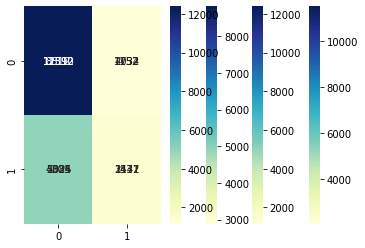

In [ ]:
# eval metric, epoc at Ir=1e-2
li100 = []

for change in ['auc', 'accuracy', 'balanced_accuracy', 'logloss']:
    for epoc in [100]:
        tab_clf = TabNetClassifier(cat_idxs=cat_idxs,
                        cat_dims=cat_dims,
                        cat_emb_dim=10,
                        optimizer_fn=torch.optim.Adam,
                        optimizer_params=dict(lr=2e-2),
                        scheduler_params={"step_size":50,
                                            "gamma":0.9},
                        scheduler_fn=torch.optim.lr_scheduler.StepLR,
                        mask_type='sparsemax' # "sparsemax", entmax
                        )
        
        max_epochs = epoc
        print(change,epoc)
        tab_clf.fit(
            X_train=X_train.values, y_train=y_train.values,
            eval_set=[(X_train.values, y_train.values), (X_valid.values, y_valid.values)],
            eval_name=['train', 'valid'],
            eval_metric=[change],
            max_epochs=max_epochs, 
            patience=50,
            batch_size=1024, virtual_batch_size=128,
            num_workers=0,
            weights=1,
            drop_last=False
        )
        y_pred_tab = tab_clf.predict(X_valid.values)
        res = {(change, epoc) : get_clf_eval(y_valid, y_pred_tab)}
        print(res)
        li100.append(res)
print(li100)

Device used : cpu
auc 100
epoch 0  | loss: 0.70774 | train_auc: 0.64913 | valid_auc: 0.49645 |  0:00:45s
epoch 1  | loss: 0.65244 | train_auc: 0.66642 | valid_auc: 0.55986 |  0:01:22s
epoch 2  | loss: 0.65117 | train_auc: 0.66514 | valid_auc: 0.49453 |  0:01:59s
epoch 3  | loss: 0.65089 | train_auc: 0.6699  | valid_auc: 0.63682 |  0:02:35s
epoch 4  | loss: 0.64992 | train_auc: 0.6697  | valid_auc: 0.63069 |  0:03:11s
epoch 5  | loss: 0.64973 | train_auc: 0.67026 | valid_auc: 0.62718 |  0:03:47s
epoch 6  | loss: 0.64812 | train_auc: 0.67048 | valid_auc: 0.61509 |  0:04:23s
epoch 7  | loss: 0.64817 | train_auc: 0.66669 | valid_auc: 0.51505 |  0:04:59s
epoch 8  | loss: 0.64837 | train_auc: 0.66814 | valid_auc: 0.55703 |  0:05:36s
epoch 9  | loss: 0.64902 | train_auc: 0.66737 | valid_auc: 0.55138 |  0:06:13s
epoch 10 | loss: 0.65014 | train_auc: 0.66827 | valid_auc: 0.55603 |  0:06:49s
epoch 11 | loss: 0.64697 | train_auc: 0.67106 | valid_auc: 0.54139 |  0:07:26s
epoch 12 | loss: 0.64804 |

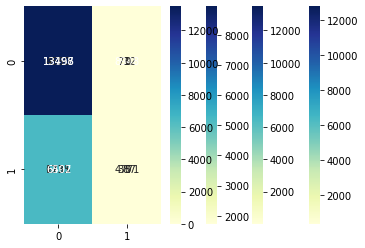

In [ ]:
# "step_size":10
li10 = []

for change in ['auc', 'accuracy', 'balanced_accuracy', 'logloss']:
    for epoc in [100]:
        tab_clf = TabNetClassifier(cat_idxs=cat_idxs,
                        cat_dims=cat_dims,
                        cat_emb_dim=10,
                        optimizer_fn=torch.optim.Adam,
                        optimizer_params=dict(lr=2e-2),
                        scheduler_params={"step_size":10,
                                            "gamma":0.9},
                        scheduler_fn=torch.optim.lr_scheduler.StepLR,
                        mask_type='sparsemax' # "sparsemax", entmax
                        )
        
        max_epochs = epoc
        print(change,epoc)
        tab_clf.fit(
            X_train=X_train.values, y_train=y_train.values,
            eval_set=[(X_train.values, y_train.values), (X_valid.values, y_valid.values)],
            eval_name=['train', 'valid'],
            eval_metric=[change],
            max_epochs=max_epochs, 
            patience=50,
            batch_size=1024, virtual_batch_size=128,
            num_workers=0,
            weights=1,
            drop_last=False
        )
        y_pred_tab = tab_clf.predict(X_valid.values)
        res = {(change, epoc) : get_clf_eval(y_valid, y_pred_tab)}
        print(res)
        li10.append(res)
print(li10)

Device used : cpu
auc 10
epoch 0  | loss: 0.71849 | train_auc: 0.55303 | valid_auc: 0.47682 |  0:00:43s
epoch 1  | loss: 0.68027 | train_auc: 0.5856  | valid_auc: 0.56977 |  0:01:22s
epoch 2  | loss: 0.67402 | train_auc: 0.6093  | valid_auc: 0.59088 |  0:02:01s
epoch 3  | loss: 0.66758 | train_auc: 0.62154 | valid_auc: 0.59176 |  0:02:40s
epoch 4  | loss: 0.66331 | train_auc: 0.61335 | valid_auc: 0.55688 |  0:03:19s
epoch 5  | loss: 0.66191 | train_auc: 0.62201 | valid_auc: 0.61631 |  0:03:59s
epoch 6  | loss: 0.6617  | train_auc: 0.63511 | valid_auc: 0.61899 |  0:04:37s
epoch 7  | loss: 0.65853 | train_auc: 0.62985 | valid_auc: 0.62457 |  0:05:16s
epoch 8  | loss: 0.65784 | train_auc: 0.64784 | valid_auc: 0.60926 |  0:05:54s
epoch 9  | loss: 0.65304 | train_auc: 0.65666 | valid_auc: 0.61803 |  0:06:32s
Stop training because you reached max_epochs = 10 with best_epoch = 7 and best_valid_auc = 0.62457
Best weights from best epoch are automatically used!

정확도accuracy: 0.6880
정밀도precision

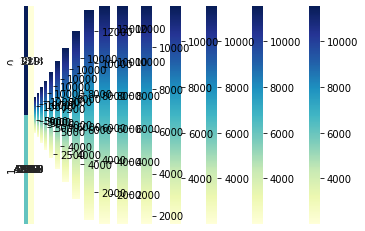

In [ ]:
# eval metric, epoc at Ir=1e-2
li = []

for change in ['auc', 'accuracy', 'balanced_accuracy', 'logloss']:
    for epoc in [10, 15, 20, 30]:
        tab_clf = TabNetClassifier(cat_idxs=cat_idxs,
                        cat_dims=cat_dims,
                        cat_emb_dim=10,
                        optimizer_fn=torch.optim.Adam,
                        optimizer_params=dict(lr=1e-2),
                        scheduler_params={"step_size":50,
                                            "gamma":0.9},
                        scheduler_fn=torch.optim.lr_scheduler.StepLR,
                        mask_type='sparsemax' # "sparsemax", entmax
                        )
        
        max_epochs = epoc
        print(change,epoc)
        tab_clf.fit(
            X_train=X_train.values, y_train=y_train.values,
            eval_set=[(X_train.values, y_train.values), (X_valid.values, y_valid.values)],
            eval_name=['train', 'valid'],
            eval_metric=[change],
            max_epochs=max_epochs, 
            patience=20,
            batch_size=1024, virtual_batch_size=128,
            num_workers=0,
            weights=1,
            drop_last=False
        )
        y_pred_tab = tab_clf.predict(X_valid.values)
        res = {(change, epoc) : get_clf_eval(y_valid, y_pred_tab)}
        print(res)
        li.append(res)
print(li)

Device used : cpu
auc 10
epoch 0  | loss: 0.70677 | train_auc: 0.55676 | valid_auc: 0.55619 |  0:00:37s
epoch 1  | loss: 0.68271 | train_auc: 0.59011 | valid_auc: 0.55778 |  0:01:15s
epoch 2  | loss: 0.67929 | train_auc: 0.60201 | valid_auc: 0.52027 |  0:01:53s
epoch 3  | loss: 0.67511 | train_auc: 0.61857 | valid_auc: 0.55343 |  0:02:31s
epoch 4  | loss: 0.66554 | train_auc: 0.65673 | valid_auc: 0.56083 |  0:03:12s
epoch 5  | loss: 0.64403 | train_auc: 0.70475 | valid_auc: 0.54309 |  0:03:50s
epoch 6  | loss: 0.61684 | train_auc: 0.73548 | valid_auc: 0.44898 |  0:04:28s
epoch 7  | loss: 0.60053 | train_auc: 0.74936 | valid_auc: 0.44839 |  0:05:06s
epoch 8  | loss: 0.59366 | train_auc: 0.6963  | valid_auc: 0.55761 |  0:05:44s
epoch 9  | loss: 0.58304 | train_auc: 0.76291 | valid_auc: 0.55782 |  0:06:22s
Stop training because you reached max_epochs = 10 with best_epoch = 4 and best_valid_auc = 0.56083
Best weights from best epoch are automatically used!

정확도accuracy: 0.3273
정밀도precision

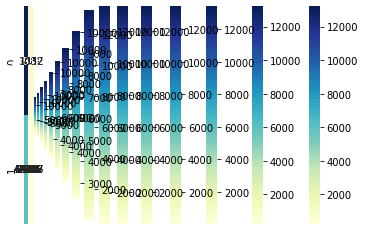

In [ ]:
# eval metric, epoc
li_default = []

for change in ['auc', 'accuracy', 'balanced_accuracy', 'logloss']:
    for epoc in [10, 15, 20, 30]:
        tab_clf = TabNetClassifier(cat_idxs=cat_idxs,
                        cat_dims=cat_dims,
                        cat_emb_dim=10,
                        optimizer_fn=torch.optim.Adam,
                        optimizer_params=dict(lr=2e-2),
                        scheduler_params={"step_size":50,
                                            "gamma":0.9},
                        scheduler_fn=torch.optim.lr_scheduler.StepLR,
                        mask_type='sparsemax' # "sparsemax", entmax
                        )
        
        max_epochs = epoc
        print(change,epoc)
        tab_clf.fit(
            X_train=X_train.values, y_train=y_train.values,
            eval_set=[(X_train.values, y_train.values), (X_valid.values, y_valid.values)],
            eval_name=['train', 'valid'],
            eval_metric=[change],
            max_epochs=max_epochs, 
            patience=20,
            batch_size=1024, virtual_batch_size=128,
            num_workers=0,
            weights=1,
            drop_last=False
        )
        y_pred_tab = tab_clf.predict(X_valid.values)
        res = {(change, epoc) : get_clf_eval(y_valid, y_pred_tab)}
        print(res)
        li_default.append(res)
print(li_default)

In [ ]:
#batchsize
li_batch = []

for bat in [512, 1024, 2048, 4096, 8192 ]:
    for vbat in [64, 128, 256]:
        tab_clf = TabNetClassifier(cat_idxs=cat_idxs,
                        cat_dims=cat_dims,
                        cat_emb_dim=10,
                        optimizer_fn=torch.optim.Adam,
                        optimizer_params=dict(lr=2e-2),
                        scheduler_params={"step_size":50,
                                            "gamma":0.9},
                        scheduler_fn=torch.optim.lr_scheduler.StepLR,
                        mask_type='sparsemax' # "sparsemax", entmax
                        )
        
        max_epochs = 30
        print(bat,vbat)
        tab_clf.fit(
            X_train=X_train.values, y_train=y_train.values,
            eval_set=[(X_train.values, y_train.values), (X_valid.values, y_valid.values)],
            eval_name=['train', 'valid'],
            eval_metric=['accuracy'],
            max_epochs=max_epochs, 
            patience=20,
            batch_size=bat, virtual_batch_size=vbat,
            num_workers=0,
            weights=1,
            drop_last=False
        )
        y_pred_tab = tab_clf.predict(X_valid.values)
        res = {(change, epoc) : get_clf_eval(y_valid, y_pred_tab)}
        print(res)
        li_batch.append(res)
print(li_batch)

In [ ]:
tab_clf = TabNetClassifier(cat_idxs=cat_idxs,
                    cat_dims=cat_dims,
                    cat_emb_dim=1,
                    optimizer_fn=torch.optim.Adam,
                    optimizer_params=dict(lr=1e-2),
                    scheduler_params={"step_size":50,
                                        "gamma":0.9},
                    scheduler_fn=torch.optim.lr_scheduler.StepLR,
                    mask_type='sparsemax' # "sparsemax", entmax
                    )

Device used : cpu


In [ ]:
max_epochs = 10

tab_clf.fit(
    X_train=X_train.values, y_train=y_train.values,
    eval_set=[(X_train.values, y_train.values), (X_valid.values, y_valid.values)],
    eval_name=['train', 'valid'],
    eval_metric=['auc'],
    max_epochs=max_epochs, 
    patience=20,
    batch_size=1024, virtual_batch_size=128,
    num_workers=0,
    weights=1,
    drop_last=False
)

IndexError: ignored


정확도accuracy: 0.6908
정밀도precision: 0.7226
재현율recall: 0.0907
AUC: 0.5369
F1: 0.1612


{'AUC': 0.5368752288765796,
 'F1': 0.16117216117216115,
 '재현율recall': 0.09070087036188731,
 '정밀도precision': 0.7226277372262774,
 '정확도accuracy': 0.69085}

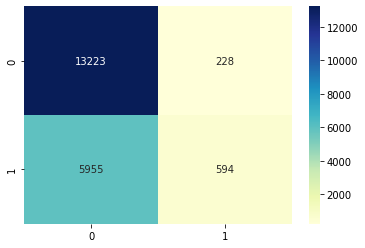

In [ ]:
y_pred_tab = tab_clf.predict(X_valid.values)
get_clf_eval(y_valid, y_pred_tab)


6


AttributeError: ignored

In [ ]:
# 제출 양식 다운로드
submit = pd.read_csv(os.path.join(folder, 'sample_submission.csv'))

# prediction 수행
df_test = pd.read_csv(os.path.join(folder, 'test.csv'))
df_test_drop = df_test.drop(columns=['ID'])
                            

 y_pred_tab = clf.predict(df_test_drop.values)
get_clf_eval(y_valid, y_pred_tab)
submit['answer'] = y_pred_tab
print(submit['answer'])


# preds = clf.predict(X_test)

IndentationError: ignored

In [ ]:
# 제출 파일 저장
submit.to_csv(os.path.join(folder, 'prediction.csv'), index=False)

In [ ]:
explain_matrix, masks = clf.explain(df_test_drop)

fig, axs = plt.subplots(1, 3, figsize=(20,20))
for i in range(3):
    axs[i].imshow(masks[i][:50])
    axs[i].set_title(f"mask {i}")

KeyError: ignored

In [ ]:
from pytorch_tabnet.tab_model import TabNetClassifier, TabNetRegressor

clf = TabNetClassifier()  #TabNetRegressor()
clf.fit(
  X_train, y_train,
  eval_set=[(X_valid, y_valid)]
)
preds = clf.predict(X_test)

Device used : cpu


KeyError: ignored

#catboost   
https://catboost.ai/en/docs/concepts/python-reference_catboostclassifier_fit

In [ ]:
!pip install catboost
from catboost import CatBoostClassifier, Pool, CatBoostRegressor

     |████████████████████████████████| 76.1 MB 1.2 MB/s 


In [ ]:
from catboost import CatBoostClassifier, Pool, CatBoostRegressor

clf_cat = CatBoostClassifier()
# clf_cat = CatBoostRegressor(iterations=10000,
#                             learning_rate=0.01,
#                             depth=5, 
#                             eval_metric='RMSE',
#                             random_seed=23,
#                             early_stopping_rounds=200,
#                             logging_level='Verbose')


Learning rate set to 0.093535
0:	learn: 0.6690429	test: 0.6691017	test1: 0.6687785	best: 0.6687785 (0)	total: 81.7ms	remaining: 1m 21s
1:	learn: 0.6501671	test: 0.6502197	test1: 0.6497907	best: 0.6497907 (1)	total: 112ms	remaining: 56.1s
2:	learn: 0.6332403	test: 0.6332941	test1: 0.6326627	best: 0.6326627 (2)	total: 145ms	remaining: 48.1s
3:	learn: 0.6203941	test: 0.6204428	test1: 0.6197672	best: 0.6197672 (3)	total: 208ms	remaining: 51.8s
4:	learn: 0.6100884	test: 0.6101252	test1: 0.6093804	best: 0.6093804 (4)	total: 295ms	remaining: 58.8s
5:	learn: 0.6011771	test: 0.6012077	test1: 0.6004510	best: 0.6004510 (5)	total: 390ms	remaining: 1m 4s
6:	learn: 0.5930003	test: 0.5930261	test1: 0.5923750	best: 0.5923750 (6)	total: 471ms	remaining: 1m 6s
7:	learn: 0.5858606	test: 0.5858842	test1: 0.5852439	best: 0.5852439 (7)	total: 514ms	remaining: 1m 3s
8:	learn: 0.5807291	test: 0.5807516	test1: 0.5799232	best: 0.5799232 (8)	total: 549ms	remaining: 1m
9:	learn: 0.5762107	test: 0.5762314	test1: 0

{'AUC': 0.6897847001855426,
 'F1': 0.5705944798301485,
 '재현율recall': 0.4986856347610948,
 '정밀도precision': 0.6667355799048997,
 '정확도accuracy': 0.7573}

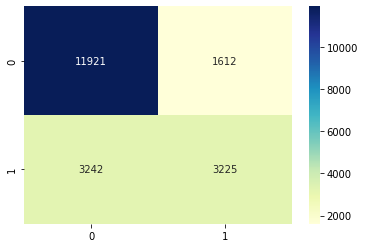

In [ ]:
max_epochs = 15

clf_cat.fit(
    X=X_train, y=y_train,
    eval_set=[(X_train, y_train), (X_valid, y_valid)],
    # eval_name=['train', 'valid'],
    # eval_metric=['balanced_accuracy'],
    # max_epochs=max_epochs , patience=20,
    # batch_size=1024, virtual_batch_size=128,
    # num_workers=0,
    # weights=1,
    # drop_last=False,
)
y_pred_vote = clf_cat.predict(X_valid)
get_clf_eval(y_valid, y_pred_vote)

# Ensemble(Voting)

In [ ]:
rnd_clf = RandomForestClassifier()
lgbm_clf = LGBMClassifier()
# xgb_clf = xgboost.XGBClassifier()

rid_clf = RidgeClassifier()
dtc_clf = DecisionTreeClassifier()
svm_clf = SVC()
ada_clf = AdaBoostClassifier()
gbc_clf = GradientBoostingClassifier()
bag_clf = BaggingClassifier()
ext_clf = ExtraTreesClassifier()
knn_clf = KNeighborsClassifier()
svc_clf = SVC()

# tabnet_clf = TabNetClassifier()
# cat_clf = CatBoostClassifier()

In [ ]:


voting_clf = VotingClassifier(estimators=[('cat',clf_cat),('rnd', rnd_clf), ('lgbm', lgbm_clf), ('xgb', xgb_clf),
                                           ('dtc', dtc_clf),  ('ada', ada_clf), ('gbc', gbc_clf), ('bag', bag_clf), ('ext', ext_clf), ('knn', knn_clf)], voting='soft')

Learning rate set to 0.06692
0:	learn: 0.6755945	total: 81.2ms	remaining: 1m 21s
1:	learn: 0.6609884	total: 159ms	remaining: 1m 19s
2:	learn: 0.6482110	total: 237ms	remaining: 1m 18s
3:	learn: 0.6371750	total: 319ms	remaining: 1m 19s
4:	learn: 0.6277920	total: 399ms	remaining: 1m 19s
5:	learn: 0.6186216	total: 435ms	remaining: 1m 12s
6:	learn: 0.6105709	total: 496ms	remaining: 1m 10s
7:	learn: 0.6041784	total: 594ms	remaining: 1m 13s
8:	learn: 0.5981062	total: 667ms	remaining: 1m 13s
9:	learn: 0.5932907	total: 722ms	remaining: 1m 11s
10:	learn: 0.5883032	total: 771ms	remaining: 1m 9s
11:	learn: 0.5838985	total: 874ms	remaining: 1m 11s
12:	learn: 0.5798548	total: 957ms	remaining: 1m 12s
13:	learn: 0.5762535	total: 1.03s	remaining: 1m 12s
14:	learn: 0.5733391	total: 1.11s	remaining: 1m 12s
15:	learn: 0.5710342	total: 1.18s	remaining: 1m 12s
16:	learn: 0.5688912	total: 1.25s	remaining: 1m 12s
17:	learn: 0.5666523	total: 1.28s	remaining: 1m 10s
18:	learn: 0.5645817	total: 1.35s	remaining: 

{'AUC': 0.6645057318609902,
 'F1': 0.522378089512358,
 '재현율recall': 0.42322560692747796,
 '정밀도precision': 0.6822033898305084,
 '정확도accuracy': 0.74975}

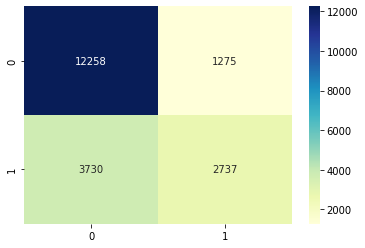

In [ ]:
voting_clf.fit(X_train, y_train)
y_pred_vote = voting_clf.predict(X_valid)
get_clf_eval(y_valid, y_pred_vote)

Learning rate set to 0.06692
0:	learn: 0.6756943	total: 95ms	remaining: 1m 34s
1:	learn: 0.6597335	total: 156ms	remaining: 1m 17s
2:	learn: 0.6469003	total: 213ms	remaining: 1m 10s
3:	learn: 0.6360037	total: 276ms	remaining: 1m 8s
4:	learn: 0.6265985	total: 309ms	remaining: 1m 1s
5:	learn: 0.6175617	total: 345ms	remaining: 57.1s
6:	learn: 0.6096017	total: 414ms	remaining: 58.7s
7:	learn: 0.6029239	total: 483ms	remaining: 59.9s
8:	learn: 0.5968911	total: 519ms	remaining: 57.1s
9:	learn: 0.5924015	total: 564ms	remaining: 55.8s
10:	learn: 0.5885136	total: 663ms	remaining: 59.6s
11:	learn: 0.5839751	total: 728ms	remaining: 59.9s
12:	learn: 0.5801771	total: 774ms	remaining: 58.8s
13:	learn: 0.5766869	total: 853ms	remaining: 1m
14:	learn: 0.5734344	total: 895ms	remaining: 58.8s
15:	learn: 0.5707184	total: 932ms	remaining: 57.3s
16:	learn: 0.5682898	total: 1s	remaining: 58.1s
17:	learn: 0.5660735	total: 1.09s	remaining: 59.4s
18:	learn: 0.5639563	total: 1.16s	remaining: 1m
19:	learn: 0.561987

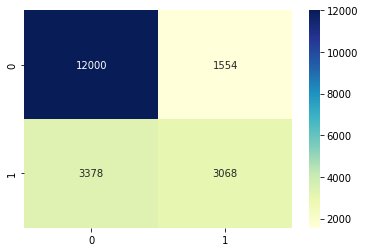

In [ ]:
for clf in (cat_clf,xgb_clf):
    clf.fit(X_train, y_train)
    y_pred_vote = clf.predict(X_valid)

# ensemble(voting) 성능 확인
get_clf_eval(y_valid, y_pred_vote)


정확도: 0.7530
정밀도: 0.6704
재현율: 0.4595
AUC: 0.6760
F1: 0.5453


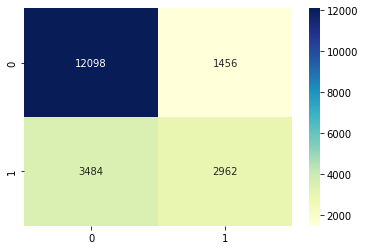

In [ ]:
get_clf_eval(y_valid, y_pred_vote)

In [ ]:
for clf in (tabnet_clf,cat_clf):
    clf.fit(X_train, y_train)
    y_pred_vote = clf.predict(X_valid)

# ensemble(voting) 성능 확인
get_clf_eval(y_valid, y_pred_vote)

NameError: ignored

#optimize

## lgbm opt

In [ ]:
!pip install scikit-optimize

In [ ]:
from skopt import BayesSearchCV

In [ ]:
opt = BayesSearchCV(
    LGBMClassifier(),
    {
        'C': (1e-6, 1e+6, 'log-uniform'),
        'gamma': (1e-6, 1e+1, 'log-uniform'),
        'degree': (1, 8),  # integer valued parameter
        'kernel': ['linear', 'poly', 'rbf'],  # categorical parameter
    },
    n_iter=32,
    cv=3
)
opt.fit(X_train, y_train)




In [ ]:
y_pred_opt = opt.predict(X_valid)

# ensemble(stacking) 성능 확인
get_clf_eval(y_valid, y_pred_opt)

## xgb opt

## cat opt

In [ ]:
CBC = CatBoostClassifier()

In [ ]:
parameters = {'depth'         : [4,5,6,7,8,9, 10],
                'learning_rate' : [0.01,0.02,0.03,0.04],
                'iterations'    : [10, 20,30,40,50,60,70,80,90, 100]
                }
Grid_CBC = GridSearchCV(estimator=CBC, param_grid = parameters, cv = 2, n_jobs=-1)
Grid_CBC.fit(X_train, y_train)
print(" Results from Grid Search " )
print("\n The best estimator across ALL searched params:\n",Grid_CBC.best_estimator_)
print("\n The best score across ALL searched params:\n",Grid_CBC.best_score_)
print("\n The best parameters across ALL searched params:\n",Grid_CBC.best_params_)

0:	learn: 0.6812293	total: 134ms	remaining: 13.3s
1:	learn: 0.6705005	total: 237ms	remaining: 11.6s
2:	learn: 0.6613077	total: 338ms	remaining: 10.9s
3:	learn: 0.6526976	total: 439ms	remaining: 10.5s
4:	learn: 0.6440242	total: 536ms	remaining: 10.2s
5:	learn: 0.6358219	total: 653ms	remaining: 10.2s
6:	learn: 0.6284185	total: 762ms	remaining: 10.1s
7:	learn: 0.6215432	total: 864ms	remaining: 9.94s
8:	learn: 0.6160566	total: 964ms	remaining: 9.75s
9:	learn: 0.6106493	total: 1.08s	remaining: 9.75s
10:	learn: 0.6053060	total: 1.18s	remaining: 9.56s
11:	learn: 0.6009955	total: 1.28s	remaining: 9.4s
12:	learn: 0.5964027	total: 1.38s	remaining: 9.24s
13:	learn: 0.5921708	total: 1.48s	remaining: 9.12s
14:	learn: 0.5876820	total: 1.58s	remaining: 8.97s
15:	learn: 0.5839143	total: 1.69s	remaining: 8.86s
16:	learn: 0.5803190	total: 1.78s	remaining: 8.71s
17:	learn: 0.5768348	total: 1.89s	remaining: 8.63s
18:	learn: 0.5736897	total: 1.99s	remaining: 8.49s
19:	learn: 0.5708085	total: 2.11s	remainin

In [ ]:
cat_clf = CatBoostClassifier(depth= 10, iterations = 100, learning_rate= 0.04,fold_len_multiplier=2)

SyntaxError: ignored

## rnd opt

# Ensemble(Stacking)

스트리밍 출력 내용이 길어서 마지막 5000줄이 삭제되었습니다.
10:	learn: 0.5931792	total: 260ms	remaining: 23.4s
11:	learn: 0.5889320	total: 284ms	remaining: 23.4s
12:	learn: 0.5847184	total: 307ms	remaining: 23.3s
13:	learn: 0.5813027	total: 330ms	remaining: 23.3s
14:	learn: 0.5782779	total: 352ms	remaining: 23.1s
15:	learn: 0.5756674	total: 377ms	remaining: 23.2s
16:	learn: 0.5725936	total: 400ms	remaining: 23.1s
17:	learn: 0.5703513	total: 428ms	remaining: 23.4s
18:	learn: 0.5679266	total: 452ms	remaining: 23.3s
19:	learn: 0.5660560	total: 472ms	remaining: 23.1s
20:	learn: 0.5642648	total: 494ms	remaining: 23s
21:	learn: 0.5623748	total: 517ms	remaining: 23s
22:	learn: 0.5606568	total: 541ms	remaining: 23s
23:	learn: 0.5589580	total: 565ms	remaining: 23s
24:	learn: 0.5576677	total: 587ms	remaining: 22.9s
25:	learn: 0.5561772	total: 608ms	remaining: 22.8s
26:	learn: 0.5548057	total: 636ms	remaining: 22.9s
27:	learn: 0.5536809	total: 660ms	remaining: 22.9s
28:	learn: 0.5526450	total: 682ms	remaining: 22.8s
29:

{'AUC': 0.6992993982683156,
 'F1': 0.5872267466780968,
 '재현율recall': 0.5296118756765115,
 '정밀도precision': 0.6589072720277029,
 '정확도accuracy': 0.75925}

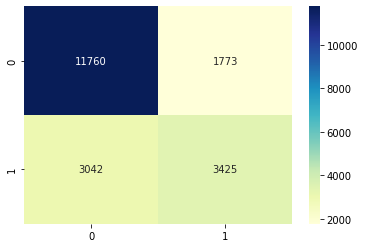

In [ ]:
stacking_clf = StackingClassifier(estimators=[('rnd', rnd_clf), ('lgbm', lgbm_clf), ('xgb', xgb_clf),('cat',clf_cat)], final_estimator = LGBMClassifier())
stacking_clf.fit(X_train, y_train)
y_pred_stack = stacking_clf.predict(X_valid)

# ensemble(stacking) 성능 확인
get_clf_eval(y_valid, y_pred_stack)

In [ ]:
import itertools
from itertools import permutations
lists = [('cat',cat_clf),('rnd', rnd_clf), ('lgbm', lgbm_clf), ('xgb', xgb_clf),  ('dtc', dtc_clf),  ('ada', ada_clf), ('gbc', gbc_clf), ('bag', bag_clf), ('ext', ext_clf), ('knn', knn_clf)]
result = []
i = 8
t=0
for j in permutations(lists, i):
    t+=1
    print(t)
    j = list(j)
    print(j)
    try:
        voting_clf = VotingClassifier(estimators=j ,  voting='soft')
        voting_clf.fit(X_train, y_train)
        y_pred_stack = voting_clf.predict(X_valid)

        # ensemble(stacking) 성능 확인
        r = get_clf_eval(y_valid, y_pred_stack)
        result.append((j, r))
        print((j, r))
    except:
        print((j, "ERROR OCCURRED"))
        result.append((j, "ERROR OCCURRED"))


스트리밍 출력 내용이 길어서 마지막 5000줄이 삭제되었습니다.
40:	learn: 0.5403068	total: 1.17s	remaining: 27.4s
41:	learn: 0.5393484	total: 1.2s	remaining: 27.3s
42:	learn: 0.5388949	total: 1.22s	remaining: 27.2s
43:	learn: 0.5383536	total: 1.25s	remaining: 27.1s
44:	learn: 0.5379683	total: 1.27s	remaining: 27s
45:	learn: 0.5373633	total: 1.32s	remaining: 27.3s
46:	learn: 0.5366414	total: 1.34s	remaining: 27.2s
47:	learn: 0.5359965	total: 1.37s	remaining: 27.2s
48:	learn: 0.5353030	total: 1.39s	remaining: 27.1s
49:	learn: 0.5349396	total: 1.42s	remaining: 26.9s
50:	learn: 0.5346372	total: 1.44s	remaining: 26.9s
51:	learn: 0.5339642	total: 1.47s	remaining: 26.8s
52:	learn: 0.5333532	total: 1.5s	remaining: 26.7s
53:	learn: 0.5328120	total: 1.53s	remaining: 26.9s
54:	learn: 0.5323470	total: 1.57s	remaining: 26.9s
55:	learn: 0.5320429	total: 1.59s	remaining: 26.9s
56:	learn: 0.5313890	total: 1.62s	remaining: 26.8s
57:	learn: 0.5310896	total: 1.65s	remaining: 26.8s
58:	learn: 0.5305498	total: 1.69s	remaining: 26.9s

# each stack

## lgbmstack

In [ ]:
lgbm_clf_gbdt = LGBMClassifier(boosting_type = 'gbdt')
lgbm_clf_rf_L1 =  LGBMClassifier(boosting_type="rf",
                         num_leaves=165,
                         colsample_bytree=.5,
                         n_estimators=400,
                         min_child_weight=5,
                         min_child_samples=10,
                         subsample=.632, # Standard RF bagging fraction
                         subsample_freq=1,
                         min_split_gain=0,
                         reg_alpha=10, # Hard L1 regularization
                         reg_lambda=0,
                         n_jobs=3)
lgbm_clf_rf_L2 =  LGBMClassifier(boosting_type="rf",
                         num_leaves=165,
                         colsample_bytree=.5,
                         n_estimators=400,
                         min_child_weight=5,
                         min_child_samples=10,
                         subsample=.632,
                         subsample_freq=1,
                         min_split_gain=0,
                         reg_alpha=0,
                         reg_lambda=5, # L2 regularization
                         n_jobs=3)
lgbm_clf_dart = LGBMClassifier(boosting_type = 'dart')
lgbm_clf_goss = LGBMClassifier(boosting_type = 'goss')

In [ ]:
lgbm_clf_gbdt.fit(X_train, y_train)

LGBMClassifier()

In [ ]:
lgbm_clf_rf_L1.fit(X_train, y_train)

LGBMClassifier(boosting_type='rf', colsample_bytree=0.5, min_child_samples=10,
               min_child_weight=5, min_split_gain=0, n_estimators=400, n_jobs=3,
               num_leaves=165, reg_alpha=10, reg_lambda=0, subsample=0.632,
               subsample_freq=1)

In [ ]:
lgbm_clf_rf_L2.fit(X_train, y_train)

In [ ]:
lgbm_clf_dart.fit(X_train, y_train)

LGBMClassifier(boosting_type='dart')

In [ ]:
lgbm_clf_goss.fit(X_train, y_train)

LGBMClassifier(boosting_type='goss')


정확도accuracy: 0.7550
정밀도precision: 0.6719
재현율recall: 0.5089
AUC: 0.6929
F1: 0.5792


{'AUC': 0.6929253923676121,
 'F1': 0.5791598659908943,
 '재현율recall': 0.5089070048309179,
 '정밀도precision': 0.6719154873430336,
 '정확도accuracy': 0.75505}

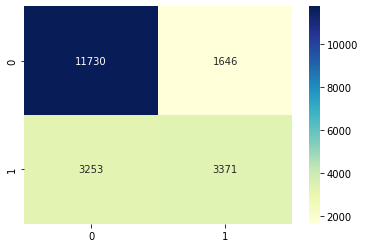

In [ ]:
stacking_lgbm_clf = StackingClassifier(estimators=[('gbdt', lgbm_clf_gbdt), ('rf1', lgbm_clf_rf_L1), ('rf2', lgbm_clf_rf_L2), ('dart', lgbm_clf_dart),('goss',lgbm_clf_goss)], final_estimator = LGBMClassifier())
stacking_lgbm_clf.fit(X_train, y_train)
y_pred_stack = stacking_lgbm_clf.predict(X_valid)

# ensemble(stacking) 성능 확인
get_clf_eval(y_valid, y_pred_stack)

## cat stack

### cat opt

In [ ]:
#optimized catboost
cat_clf_default = CatBoostClassifier(depth= 10, iterations = 100, learning_rate= 0.04, fold_len_multiplier=2)

In [ ]:
cat_clf_default.fit(X_train, y_train)
y_pred_stack = cat_clf_default.predict(X_valid)

# ensemble(stacking) 성능 확인
get_clf_eval(y_valid, y_pred_stack)

In [ ]:
cat_clf_onehot3 = CatBoostClassifier(depth= 10, iterations = 100, learning_rate= 0.04, fold_len_multiplier=2, one_hot_max_size = 3)
cat_clf_onehot40 = CatBoostClassifier(depth= 10, iterations = 100, learning_rate= 0.04, fold_len_multiplier=2, one_hot_max_size = 40)

In [ ]:
cat_clf_onehot3.fit(X_train, y_train)
y_pred_stack = cat_clf_onehot3.predict(X_valid)

# ensemble(stacking) 성능 확인
get_clf_eval(y_valid, y_pred_stack)

In [ ]:
cat_clf_onehot40.fit(X_train, y_train)
y_pred_stack = cat_clf_onehot40.predict(X_valid)

# ensemble(stacking) 성능 확인
get_clf_eval(y_valid, y_pred_stack)

## xgb stack

### xgb opt

## rnd stack

## h2o

In [2]:
!pip install h2o

     |████████████████████████████████| 176.0 MB 6.4 kB/s 
  Created wheel for h2o: filename=h2o-3.36.0.2-py2.py3-none-any.whl size=176112127 sha256=a91e6dd8f00c5c138e7e74ee9389e59d5767d241ea897ca8e4d8bc682b3b41aa
  Stored in directory: /root/.cache/pip/wheels/0b/83/bd/343a6140119b4098103e725e1cfe9f198568d13cf103acbc7c
Successfully built h2o


In [16]:
import h2o
from h2o.automl import H2OAutoML
import pandas as pd
import os
from sklearn.model_selection import train_test_split
h2o.init()

Checking whether there is an H2O instance running at http://localhost:54321 . connected.


H2O_cluster_uptime:,1 min 43 secs
H2O_cluster_timezone:,Etc/UTC
H2O_data_parsing_timezone:,UTC
H2O_cluster_version:,3.36.0.2
H2O_cluster_version_age:,11 days
H2O_cluster_name:,H2O_from_python_unknownUser_xc5z8w
H2O_cluster_total_nodes:,1
H2O_cluster_free_memory:,3.172 Gb
H2O_cluster_total_cores:,2
H2O_cluster_allowed_cores:,2
H2O_cluster_status:,"locked, healthy"


In [17]:
h2o.no_progress()

In [18]:
df = pd.read_csv(os.path.join(folder, 'train.csv'))

In [19]:
x = df.drop('depvar', axis=1)
y = df['depvar']

In [23]:
max_runtime_secs = 300

In [21]:
# Identify the response and set of predictors
y = "depvar"
x = list(df.columns)  #if x is defined as all columns except the response, then x is not required
x.remove(y)

# df을 8:2로 나눈다, 50 : 13
train, valid = train_test_split(df,
                                test_size=0.2,
                                shuffle=True 
                                )
h2o_train = h2o.H2OFrame(train)
h2o_valid = h2o.H2OFrame(valid)

# For binary classification, response should be a factor
h2o_train[y] = h2o_train[y].asfactor()
h2o_valid[y] = h2o_valid[y].asfactor()

In [24]:
aml = H2OAutoML(
                                max_runtime_secs=max_runtime_secs,
                                # max_models =40,
                                balance_classes=True,

                                )


In [25]:
# max_runtime_secs = 300
aml.train(x = x, y = y, training_frame=h2o_train, leaderboard_frame=h2o_valid)


05:07:34.541: _train param, Dropping bad and constant columns: [purpose4]


05:08:00.953: _train param, Dropping bad and constant columns: [purpose4]


05:08:10.38: _train param, Dropping bad and constant columns: [purpose4]


05:08:51.722: _train param, Dropping unused columns: [purpose4]


05:08:57.585: _train param, Dropping bad and constant columns: [purpose4]


05:09:11.727: _train param, Dropping bad and constant columns: [purpose4]


05:09:50.314: _train param, Dropping bad and constant columns: [purpose4]


05:10:17.939: _train param, Dropping bad and constant columns: [purpose4]


05:10:44.448: _train param, Dropping bad and constant columns: [purpose4]


05:11:10.915: _train param, Dropping unused columns: [purpose4]


05:11:15.584: _train param, Dropping unused columns: [purpose4]


05:11:24.349: _train param, Dropping bad and constant columns: [purpose4]


05:11:38.486: _train param, Dropping bad and constant columns: [purpose4]


05:11:51.693: _train param, Dropping bad a

,,0,1,Error,Rate
0,0,5503.0,1097.0,0.1662,(1097.0/6600.0)
1,1,692.0,2559.0,0.2129,(692.0/3251.0)
2,Total,6195.0,3656.0,0.1816,(1789.0/9851.0)



Maximum Metrics: Maximum metrics at their respective thresholds


,metric,threshold,value,idx
0,max f1,0.378687,0.740987,207.0
1,max f2,0.208046,0.834191,284.0
2,max f0point5,0.541802,0.758543,141.0
3,max accuracy,0.470611,0.828139,170.0
4,max precision,0.970021,1.000000,0.0
5,max recall,0.056238,1.000000,377.0
6,max specificity,0.970021,1.000000,0.0
7,max absolute_mcc,0.404419,0.606018,196.0
8,max min_per_class_accuracy,0.354098,0.810455,218.0
9,max mean_per_class_accuracy,0.299703,0.813963,242.0



Gains/Lift Table: Avg response rate: 33.00 %, avg score: 32.81 %


,group,cumulative_data_fraction,lower_threshold,lift,cumulative_lift,response_rate,score,cumulative_response_rate,cumulative_score,capture_rate,cumulative_capture_rate,gain,cumulative_gain,kolmogorov_smirnov
0,1,0.010050,0.887002,3.030145,3.030145,1.000000,0.912628,1.000000,0.912628,0.030452,0.030452,203.014457,203.014457,0.030452
1,2,0.020099,0.859378,2.999537,3.014841,0.989899,0.872446,0.994949,0.892537,0.030145,0.060597,199.953705,201.484081,0.060445
2,3,0.030048,0.836862,2.999225,3.009671,0.989796,0.847395,0.993243,0.877591,0.029837,0.090434,199.922473,200.967062,0.090131
3,4,0.040097,0.817190,2.968930,2.999460,0.979798,0.826082,0.989873,0.864681,0.029837,0.120271,196.892953,199.945956,0.119665
4,5,0.050046,0.798529,3.030145,3.005559,1.000000,0.808612,0.991886,0.853536,0.030145,0.150415,203.014457,200.555922,0.149809
5,6,0.100091,0.725826,2.753559,2.879559,0.908722,0.761459,0.950304,0.807498,0.137804,0.288219,175.355937,187.955929,0.280795
6,7,0.150036,0.652457,2.432738,2.730820,0.802846,0.688340,0.901218,0.767832,0.121501,0.409720,143.273802,173.082041,0.387599
7,8,0.200081,0.583489,2.059023,2.562786,0.679513,0.617531,0.845764,0.730238,0.103045,0.512765,105.902319,156.278590,0.466705
8,9,0.300071,0.461371,1.802705,2.309511,0.594924,0.518598,0.762179,0.659715,0.180252,0.693018,80.270530,130.951141,0.586502
9,10,0.400061,0.348176,1.227439,2.039062,0.405076,0.402956,0.672926,0.595542,0.122731,0.815749,22.743927,103.906202,0.620446




ModelMetricsBinomialGLM: stackedensemble
** Reported on validation data. **

MSE: 0.1629376195521585
RMSE: 0.40365532271005483
LogLoss: 0.4927838689941968
Null degrees of freedom: 7963
Residual degrees of freedom: 7956
Null deviance: 10068.201845041085
Residual deviance: 7849.061465339567
AIC: 7865.061465339567
AUC: 0.8078142174948129
AUCPR: 0.6615862985565624
Gini: 0.6156284349896257

Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.30407599381980527: 


,,0,1,Error,Rate
0,0,3828.0,1531.0,0.2857,(1531.0/5359.0)
1,1,625.0,1980.0,0.2399,(625.0/2605.0)
2,Total,4453.0,3511.0,0.2707,(2156.0/7964.0)



Maximum Metrics: Maximum metrics at their respective thresholds


,metric,threshold,value,idx
0,max f1,0.304076,0.647482,236.0
1,max f2,0.161882,0.761156,310.0
2,max f0point5,0.493274,0.634814,156.0
3,max accuracy,0.493274,0.760171,156.0
4,max precision,0.919535,0.968750,6.0
5,max recall,0.021157,1.000000,396.0
6,max specificity,0.955511,0.999813,0.0
7,max absolute_mcc,0.360752,0.452402,212.0
8,max min_per_class_accuracy,0.325010,0.737044,226.0
9,max mean_per_class_accuracy,0.319096,0.737245,229.0



Gains/Lift Table: Avg response rate: 32.71 %, avg score: 32.62 %


,group,cumulative_data_fraction,lower_threshold,lift,cumulative_lift,response_rate,score,cumulative_response_rate,cumulative_score,capture_rate,cumulative_capture_rate,gain,cumulative_gain,kolmogorov_smirnov
0,1,0.010045,0.881685,2.789693,2.789693,0.912500,0.910608,0.912500,0.910608,0.028023,0.028023,178.969290,178.969290,0.026717
1,2,0.020090,0.842871,2.483973,2.636833,0.812500,0.859850,0.862500,0.885229,0.024952,0.052975,148.397313,163.683301,0.048870
2,3,0.030010,0.816526,2.554115,2.609491,0.835443,0.829053,0.853556,0.866660,0.025336,0.078311,155.411453,160.949092,0.071780
3,4,0.040055,0.793499,2.254683,2.520511,0.737500,0.806154,0.824451,0.851486,0.022649,0.100960,125.468330,152.051095,0.090510
4,5,0.050100,0.777950,2.407543,2.497861,0.787500,0.785359,0.817043,0.838228,0.024184,0.125144,140.754319,149.786077,0.111522
5,6,0.100075,0.702623,2.158474,2.328380,0.706030,0.738483,0.761606,0.788418,0.107869,0.233013,115.847375,132.838018,0.197559
6,7,0.150050,0.639478,2.004846,2.220626,0.655779,0.670328,0.726360,0.749088,0.100192,0.333205,100.484573,122.062561,0.272187
7,8,0.200025,0.572726,1.820492,2.120655,0.595477,0.606818,0.693660,0.713543,0.090979,0.424184,82.049210,112.065503,0.333122
8,9,0.299975,0.454237,1.632298,1.957937,0.533920,0.513169,0.640435,0.646779,0.163148,0.587332,63.229777,95.793741,0.427041
9,10,0.400050,0.342706,1.288856,1.790562,0.421581,0.397509,0.585687,0.584423,0.128983,0.716315,28.885624,79.056212,0.470000


In [53]:
# max_runtime_secs = 600
aml.train(x = x, y = y, training_frame=h2o_train, leaderboard_frame=h2o_valid)


04:49:34.428: _train param, Dropping bad and constant columns: [purpose4]


04:49:54.604: _train param, Dropping bad and constant columns: [purpose4]


04:50:00.665: _train param, Dropping bad and constant columns: [purpose4]


04:50:37.204: _train param, Dropping unused columns: [purpose4]


04:50:40.915: _train param, Dropping bad and constant columns: [purpose4]


04:50:53.66: _train param, Dropping bad and constant columns: [purpose4]


04:51:36.756: _train param, Dropping bad and constant columns: [purpose4]


04:52:07.339: _train param, Dropping bad and constant columns: [purpose4]


04:52:34.829: _train param, Dropping bad and constant columns: [purpose4]


04:53:01.279: _train param, Dropping unused columns: [purpose4]


04:53:05.968: _train param, Dropping unused columns: [purpose4]


04:53:13.738: _train param, Dropping bad and constant columns: [purpose4]


04:53:27.880: _train param, Dropping bad and constant columns: [purpose4]


04:54:03.436: _train param, Dropping bad a

,,0,1,Error,Rate
0,0,5460.0,1357.0,0.1991,(1357.0/6817.0)
1,1,564.0,2624.0,0.1769,(564.0/3188.0)
2,Total,6024.0,3981.0,0.192,(1921.0/10005.0)



Maximum Metrics: Maximum metrics at their respective thresholds


,metric,threshold,value,idx
0,max f1,0.343451,0.732041,220.0
1,max f2,0.228037,0.830638,271.0
2,max f0point5,0.589992,0.757140,120.0
3,max accuracy,0.504220,0.828586,154.0
4,max precision,0.970806,1.000000,0.0
5,max recall,0.061147,1.000000,372.0
6,max specificity,0.970806,1.000000,0.0
7,max absolute_mcc,0.427499,0.596672,184.0
8,max min_per_class_accuracy,0.352460,0.808420,216.0
9,max mean_per_class_accuracy,0.291941,0.814974,242.0



Gains/Lift Table: Avg response rate: 31.86 %, avg score: 32.35 %


,group,cumulative_data_fraction,lower_threshold,lift,cumulative_lift,response_rate,score,cumulative_response_rate,cumulative_score,capture_rate,cumulative_capture_rate,gain,cumulative_gain,kolmogorov_smirnov
0,1,0.010095,0.900756,3.138331,3.138331,1.000000,0.924972,1.000000,0.924972,0.031681,0.031681,213.833124,213.833124,0.031681
1,2,0.020090,0.867436,3.106948,3.122718,0.990000,0.884334,0.995025,0.904754,0.031054,0.062735,210.694793,212.271765,0.062589
2,3,0.030085,0.843012,3.075565,3.107052,0.980000,0.854166,0.990033,0.887947,0.030740,0.093476,207.556462,210.705219,0.093035
3,4,0.040080,0.825700,3.044181,3.091374,0.970000,0.833970,0.985037,0.874487,0.030427,0.123902,204.418130,209.137367,0.123022
4,5,0.050075,0.805969,3.044181,3.081954,0.970000,0.815665,0.982036,0.862746,0.030427,0.154329,204.418130,208.195403,0.153009
5,6,0.100050,0.717690,2.918648,3.000383,0.930000,0.759802,0.956044,0.811325,0.145859,0.300188,191.864806,200.038262,0.293734
6,7,0.150025,0.645194,2.435345,2.812162,0.776000,0.682419,0.896069,0.768385,0.121706,0.421895,143.534504,181.216224,0.399011
7,8,0.200000,0.573566,2.165449,2.650565,0.690000,0.609875,0.844578,0.728777,0.108218,0.530113,116.544856,165.056462,0.484492
8,9,0.300050,0.446858,1.683600,2.328136,0.536464,0.508935,0.741839,0.655472,0.168444,0.698557,68.360028,132.813580,0.584871
9,10,0.400000,0.339677,1.271024,2.063990,0.405000,0.392991,0.657671,0.589885,0.127039,0.825596,27.102415,106.398996,0.624628




ModelMetricsBinomialGLM: stackedensemble
** Reported on validation data. **

MSE: 0.160871348301194
RMSE: 0.4010877064947192
LogLoss: 0.4885779010456527
Null degrees of freedom: 7963
Residual degrees of freedom: 7950
Null deviance: 10059.948346744175
Residual deviance: 7782.068807855155
AIC: 7810.068807855155
AUC: 0.8117463631255408
AUCPR: 0.6694055139147773
Gini: 0.6234927262510817

Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.32323701447345826: 


,,0,1,Error,Rate
0,0,3951.0,1414.0,0.2636,(1414.0/5365.0)
1,1,648.0,1951.0,0.2493,(648.0/2599.0)
2,Total,4599.0,3365.0,0.2589,(2062.0/7964.0)



Maximum Metrics: Maximum metrics at their respective thresholds


,metric,threshold,value,idx
0,max f1,0.323237,0.654259,236.0
1,max f2,0.170384,0.764542,307.0
2,max f0point5,0.481384,0.643433,169.0
3,max accuracy,0.481384,0.765696,169.0
4,max precision,0.973708,1.000000,0.0
5,max recall,0.022513,1.000000,397.0
6,max specificity,0.973708,1.000000,0.0
7,max absolute_mcc,0.323237,0.462374,236.0
8,max min_per_class_accuracy,0.332335,0.742777,232.0
9,max mean_per_class_accuracy,0.323237,0.743557,236.0



Gains/Lift Table: Avg response rate: 32.63 %, avg score: 32.62 %


,group,cumulative_data_fraction,lower_threshold,lift,cumulative_lift,response_rate,score,cumulative_response_rate,cumulative_score,capture_rate,cumulative_capture_rate,gain,cumulative_gain,kolmogorov_smirnov
0,1,0.010045,0.894644,2.642920,2.642920,0.862500,0.920987,0.862500,0.920987,0.026549,0.026549,164.292035,164.292035,0.024498
1,2,0.020090,0.848568,2.681224,2.662072,0.875000,0.869993,0.868750,0.895490,0.026933,0.053482,168.122355,166.207195,0.049568
2,3,0.030010,0.819939,2.521223,2.615515,0.822785,0.834853,0.853556,0.875447,0.025010,0.078492,152.122287,161.551514,0.071968
3,4,0.040055,0.797441,2.489708,2.583965,0.812500,0.807917,0.843260,0.858511,0.025010,0.103501,148.970758,158.396465,0.094182
4,5,0.050100,0.780924,2.528011,2.572746,0.825000,0.788879,0.839599,0.844550,0.025394,0.128896,152.801077,157.274583,0.116967
5,6,0.100075,0.703601,2.225050,2.399116,0.726131,0.741154,0.782936,0.792917,0.111197,0.240092,122.504984,139.911596,0.207846
6,7,0.150050,0.634934,1.978678,2.259087,0.645729,0.669096,0.737238,0.751678,0.098884,0.338977,97.867754,125.908710,0.280449
7,8,0.200025,0.571118,1.763102,2.135169,0.575377,0.603293,0.696798,0.714605,0.088111,0.427087,76.310177,113.516860,0.337059
8,9,0.299975,0.450656,1.693810,1.988111,0.552764,0.508996,0.648807,0.646097,0.169296,0.596383,69.380956,98.811051,0.439999
9,10,0.400050,0.347246,1.257229,1.805275,0.410289,0.399117,0.589140,0.584313,0.125818,0.722201,25.722904,80.527544,0.478212


In [12]:
# max_runtime_secs = 1800
aml.train(x = x, y = y, training_frame=h2o_train, leaderboard_frame=h2o_valid)


20:58:08.907: _train param, Dropping bad and constant columns: [purpose4]


21:01:01.257: _train param, Dropping bad and constant columns: [purpose4]


21:03:09.367: _train param, Dropping bad and constant columns: [purpose4]


21:07:27.819: _train param, Dropping unused columns: [purpose4]


21:07:32.696: _train param, Dropping bad and constant columns: [purpose4]


21:09:24.857: _train param, Dropping bad and constant columns: [purpose4]


21:16:07.788: _train param, Dropping bad and constant columns: [purpose4]


21:20:07.397: _train param, Dropping bad and constant columns: [purpose4]


21:23:52.993: _train param, Dropping bad and constant columns: [purpose4]


21:27:34.489: _train param, Dropping unused columns: [purpose4]


21:27:38.201: _train param, Dropping unused columns: [purpose4]


21:27:46.42: _train param, Dropping bad and constant columns: [purpose4]


21:29:51.204: _train param, Dropping bad and constant columns: [purpose4]


21:33:49.591: _train param, Dropping bad a

,,0,1,Error,Rate
0,0,5564.0,1289.0,0.1881,(1289.0/6853.0)
1,1,652.0,2589.0,0.2012,(652.0/3241.0)
2,Total,6216.0,3878.0,0.1923,(1941.0/10094.0)



Maximum Metrics: Maximum metrics at their respective thresholds


,metric,threshold,value,idx
0,max f1,0.371959,0.727349,214.0
1,max f2,0.207956,0.822606,283.0
2,max f0point5,0.586808,0.748966,127.0
3,max accuracy,0.515725,0.822073,155.0
4,max precision,0.968075,1.000000,0.0
5,max recall,0.051341,1.000000,378.0
6,max specificity,0.968075,1.000000,0.0
7,max absolute_mcc,0.408452,0.589077,200.0
8,max min_per_class_accuracy,0.365939,0.804381,217.0
9,max mean_per_class_accuracy,0.371959,0.805367,214.0



Gains/Lift Table: Avg response rate: 32.11 %, avg score: 32.48 %


,group,cumulative_data_fraction,lower_threshold,lift,cumulative_lift,response_rate,score,cumulative_response_rate,cumulative_score,capture_rate,cumulative_capture_rate,gain,cumulative_gain,kolmogorov_smirnov
0,1,0.010006,0.902803,3.114471,3.114471,1.000000,0.926825,1.000000,0.926825,0.031163,0.031163,211.447084,211.447084,0.031163
1,2,0.020012,0.873503,3.083634,3.099053,0.990099,0.886379,0.995050,0.906602,0.030855,0.062018,208.363450,209.905267,0.061872
2,3,0.030018,0.841575,3.052798,3.083634,0.980198,0.856519,0.990099,0.889908,0.030546,0.092564,205.279815,208.363450,0.092126
3,4,0.040024,0.823383,2.960289,3.052798,0.950495,0.831781,0.980198,0.875376,0.029620,0.122185,196.028912,205.279815,0.121017
4,5,0.050030,0.805474,3.021962,3.046631,0.970297,0.813840,0.978218,0.863069,0.030238,0.152422,202.196181,204.663088,0.150817
5,6,0.100059,0.719071,2.824609,2.935620,0.906931,0.759084,0.942574,0.811077,0.141314,0.293737,182.460920,193.562004,0.285273
6,7,0.149990,0.651165,2.496520,2.789447,0.801587,0.685512,0.895641,0.769277,0.124653,0.418389,149.652028,178.944680,0.395334
7,8,0.200020,0.587661,2.090704,2.614675,0.671287,0.619371,0.839525,0.731782,0.104597,0.522987,109.070419,161.467463,0.475708
8,9,0.299980,0.465613,1.642119,2.290597,0.527255,0.526337,0.735469,0.663323,0.164147,0.687134,64.211941,129.059662,0.570250
9,10,0.400040,0.353021,1.255039,2.031579,0.402970,0.410213,0.652303,0.600014,0.125579,0.812712,25.503924,103.157905,0.607838




ModelMetricsBinomialGLM: stackedensemble
** Reported on cross-validation data. **

MSE: 0.16206532755153744
RMSE: 0.40257338157351813
LogLoss: 0.4906781159974529
Null degrees of freedom: 79999
Residual degrees of freedom: 79982
Null deviance: 100940.97153465313
Residual deviance: 78508.49855959248
AIC: 78544.49855959248
AUC: 0.8082610208579748
AUCPR: 0.6681631404104763
Gini: 0.6165220417159496

Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.29306707436640367: 


,,0,1,Error,Rate
0,0,37734.0,16234.0,0.3008,(16234.0/53968.0)
1,1,5963.0,20069.0,0.2291,(5963.0/26032.0)
2,Total,43697.0,36303.0,0.2775,(22197.0/80000.0)



Maximum Metrics: Maximum metrics at their respective thresholds


,metric,threshold,value,idx
0,max f1,0.293067,0.643908,245.0
1,max f2,0.145131,0.759618,320.0
2,max f0point5,0.505131,0.629458,156.0
3,max accuracy,0.505131,0.758363,156.0
4,max precision,0.979971,1.000000,0.0
5,max recall,0.017921,1.000000,398.0
6,max specificity,0.979971,1.000000,0.0
7,max absolute_mcc,0.358750,0.445096,215.0
8,max min_per_class_accuracy,0.326705,0.733342,229.0
9,max mean_per_class_accuracy,0.293067,0.735064,245.0



Gains/Lift Table: Avg response rate: 32.54 %, avg score: 32.54 %


,group,cumulative_data_fraction,lower_threshold,lift,cumulative_lift,response_rate,score,cumulative_response_rate,cumulative_score,capture_rate,cumulative_capture_rate,gain,cumulative_gain,kolmogorov_smirnov
0,1,0.01,0.880799,2.854179,2.854179,0.928750,0.910251,0.928750,0.910251,0.028542,0.028542,185.417947,185.417947,0.027486
1,2,0.02,0.843161,2.700522,2.777351,0.878750,0.860911,0.903750,0.885581,0.027005,0.055547,170.052243,177.735095,0.052693
2,3,0.03,0.817607,2.589121,2.714608,0.842500,0.829603,0.883333,0.866922,0.025891,0.081438,158.912108,171.460766,0.076250
3,4,0.04,0.795559,2.431623,2.643861,0.791250,0.806003,0.860313,0.851692,0.024316,0.105754,143.162262,164.386140,0.097472
4,5,0.05,0.776882,2.404733,2.596036,0.782500,0.786341,0.844750,0.838622,0.024047,0.129802,140.473264,159.603565,0.118295
5,6,0.10,0.701183,2.209588,2.402812,0.719000,0.737029,0.781875,0.787825,0.110479,0.240281,120.958820,140.281192,0.207947
6,7,0.15,0.638075,1.977566,2.261063,0.643500,0.669740,0.735750,0.748463,0.098878,0.339159,97.756607,126.106331,0.280402
7,8,0.20,0.575415,1.813921,2.149278,0.590250,0.606552,0.699375,0.712986,0.090696,0.429856,81.392133,114.927781,0.340729
8,9,0.30,0.454885,1.563460,1.954005,0.508750,0.513681,0.635833,0.646551,0.156346,0.586202,56.346036,95.400533,0.424254
9,10,0.40,0.344320,1.273817,1.783958,0.414500,0.398258,0.580500,0.584478,0.127382,0.713583,27.381684,78.395821,0.464843


In [14]:
## save metric
# Print Leaderboard (ranked by xval metrics)
leaderboard = aml.leaderboard
performance = aml.leader.model_performance(h2o_valid)  # (Optional) Evaluate performance on a test set

model_id   =aml.leader.model_id  # 최고 모델 명
accuracy   =performance.accuracy()  # 정확도
precision  =performance.precision()  # precision
recall     =performance.recall()  # recall
F1         =performance.F1()  # f1
auc        =performance.auc()  # auc
variable_importance=aml.leader.varimp()  # 중요한 입력 변수

print(model_id, accuracy, precision, recall, F1, auc, variable_importance)
print(performance)

StackedEnsemble_AllModels_6_AutoML_2_20220205_142212 [[0.49631654391422936, 0.7573]] [[0.9370964552729613, 0.9523809523809523]] [[0.033366234768223424, 1.0]] [[0.35195699280102777, 0.6468624833110813]] 0.8080544288080969 None

ModelMetricsBinomial: stackedensemble
** Reported on test data. **

MSE: 0.16282042919523937
RMSE: 0.4035101351827973
LogLoss: 0.49257322047276664
Mean Per-Class Error: 0.2644045556673774
AUC: 0.8080544288080969
AUCPR: 0.6685240601517679
Gini: 0.6161088576161937

Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.35195699280102777: 


,,0,1,Error,Rate
0,0,9865.0,3551.0,0.2647,(3551.0/13416.0)
1,1,1739.0,4845.0,0.2641,(1739.0/6584.0)
2,Total,11604.0,8396.0,0.2645,(5290.0/20000.0)



Maximum Metrics: Maximum metrics at their respective thresholds


,metric,threshold,value,idx
0,max f1,0.351957,0.646862,227.0
1,max f2,0.138482,0.764792,328.0
2,max f0point5,0.505457,0.632642,153.0
3,max accuracy,0.496317,0.757300,157.0
4,max precision,0.937096,0.952381,0.0
5,max recall,0.033366,1.000000,398.0
6,max specificity,0.937096,0.999925,0.0
7,max absolute_mcc,0.353744,0.448877,226.0
8,max min_per_class_accuracy,0.351957,0.735316,227.0
9,max mean_per_class_accuracy,0.351957,0.735595,227.0



Gains/Lift Table: Avg response rate: 32.92 %, avg score: 32.33 %


,group,cumulative_data_fraction,lower_threshold,lift,cumulative_lift,response_rate,score,cumulative_response_rate,cumulative_score,capture_rate,cumulative_capture_rate,gain,cumulative_gain,kolmogorov_smirnov
0,1,0.01,0.912294,2.749089,2.749089,0.9050,0.927284,0.905000,0.927284,0.027491,0.027491,174.908870,174.908870,0.026075
1,2,0.02,0.872741,2.612394,2.680741,0.8600,0.894614,0.882500,0.910949,0.026124,0.053615,161.239368,168.074119,0.050112
2,3,0.03,0.828675,2.582017,2.647833,0.8500,0.849352,0.871667,0.890417,0.025820,0.079435,158.201701,164.783313,0.073696
3,4,0.04,0.794424,2.521264,2.616191,0.8300,0.811382,0.861250,0.870658,0.025213,0.104648,152.126367,161.619077,0.096374
4,5,0.05,0.768498,2.384569,2.569866,0.7850,0.782012,0.846000,0.852929,0.023846,0.128493,138.456865,156.986634,0.117014
5,6,0.10,0.674066,2.226610,2.398238,0.7330,0.717399,0.789500,0.785164,0.111330,0.239824,122.660996,139.823815,0.208443
6,7,0.15,0.611856,1.916768,2.237748,0.6310,0.642821,0.736667,0.737716,0.095838,0.335662,91.676792,123.774808,0.276777
7,8,0.20,0.554878,1.755772,2.117254,0.5780,0.582475,0.697000,0.698906,0.087789,0.423451,75.577157,111.725395,0.333111
8,9,0.30,0.461115,1.602369,1.945626,0.5275,0.508302,0.640500,0.635371,0.160237,0.583688,60.236938,94.562576,0.422910
9,10,0.40,0.368844,1.277339,1.778554,0.4205,0.415576,0.585500,0.580423,0.127734,0.711422,27.733900,77.855407,0.464254


In [14]:
explain_model = aml.explain(frame = valid, figsize = (8,6))

AttributeError: ignored

In [36]:
# max_models =30
aml.train(x = x, y = y, training_frame=h2o_train, leaderboard_frame=h2o_valid)


23:21:55.410: _train param, Dropping bad and constant columns: [purpose4]


23:24:19.629: _train param, Dropping bad and constant columns: [purpose4]


23:26:46.719: _train param, Dropping bad and constant columns: [purpose4]


23:32:33.344: _train param, Dropping unused columns: [purpose4]


23:32:37.86: _train param, Dropping bad and constant columns: [purpose4]


23:34:35.262: _train param, Dropping bad and constant columns: [purpose4]


23:42:06.326: _train param, Dropping bad and constant columns: [purpose4]


23:46:17.894: _train param, Dropping bad and constant columns: [purpose4]


23:50:33.463: _train param, Dropping bad and constant columns: [purpose4]


23:54:54.8: _train param, Dropping unused columns: [purpose4]


23:54:57.677: _train param, Dropping unused columns: [purpose4]


23:55:05.646: _train param, Dropping bad and constant columns: [purpose4]


23:57:13.823: _train param, Dropping bad and constant columns: [purpose4]


00:03:06.516: _train param, Dropping bad and

,,0,1,Error,Rate
0,0,5340.0,1372.0,0.2044,(1372.0/6712.0)
1,1,689.0,2573.0,0.2112,(689.0/3262.0)
2,Total,6029.0,3945.0,0.2066,(2061.0/9974.0)



Maximum Metrics: Maximum metrics at their respective thresholds


,metric,threshold,value,idx
0,max f1,0.387383,0.714028,213.0
1,max f2,0.208649,0.815788,295.0
2,max f0point5,0.546054,0.708858,139.0
3,max accuracy,0.434405,0.799378,191.0
4,max precision,0.947010,1.000000,0.0
5,max recall,0.058911,1.000000,383.0
6,max specificity,0.947010,1.000000,0.0
7,max absolute_mcc,0.387383,0.560673,213.0
8,max min_per_class_accuracy,0.383332,0.791232,215.0
9,max mean_per_class_accuracy,0.337500,0.793418,236.0



Gains/Lift Table: Avg response rate: 32.71 %, avg score: 33.08 %


,group,cumulative_data_fraction,lower_threshold,lift,cumulative_lift,response_rate,score,cumulative_response_rate,cumulative_score,capture_rate,cumulative_capture_rate,gain,cumulative_gain,kolmogorov_smirnov
0,1,0.010026,0.901939,3.027057,3.027057,0.990000,0.920340,0.990000,0.920340,0.030349,0.030349,202.705702,202.705702,0.030200
1,2,0.020052,0.870759,2.904752,2.965904,0.950000,0.886541,0.970000,0.903440,0.029123,0.059473,190.475169,196.590435,0.058579
2,3,0.030078,0.840572,2.996481,2.976096,0.980000,0.855483,0.973333,0.887455,0.030043,0.089516,199.648069,197.609646,0.088324
3,4,0.040004,0.812186,2.995863,2.981001,0.979798,0.826455,0.974937,0.872319,0.029736,0.119252,199.586298,198.100094,0.117762
4,5,0.050030,0.779579,2.843599,2.953465,0.930000,0.793788,0.965932,0.856582,0.028510,0.147762,184.359902,195.346548,0.145229
5,6,0.100060,0.689926,2.622579,2.788022,0.857715,0.730094,0.911824,0.793338,0.131208,0.278970,162.257931,178.802240,0.265859
6,7,0.149990,0.629175,2.333134,2.636596,0.763052,0.658824,0.862299,0.748560,0.116493,0.395463,133.313388,163.659561,0.364772
7,8,0.200020,0.569568,1.807619,2.429248,0.591182,0.600184,0.794486,0.711447,0.090435,0.485898,80.761892,142.924755,0.424814
8,9,0.299980,0.477949,1.597820,2.152198,0.522568,0.521527,0.703877,0.648162,0.159718,0.645616,59.782044,115.219781,0.513614
9,10,0.400040,0.382230,1.464478,1.980182,0.478958,0.432392,0.647619,0.594192,0.146536,0.792152,46.447770,98.018160,0.582676




ModelMetricsBinomial: stackedensemble
** Reported on cross-validation data. **

MSE: 0.16159093663717933
RMSE: 0.4019837517079258
LogLoss: 0.4889653467293615
Mean Per-Class Error: 0.2642254619323231
AUC: 0.809137177454039
AUCPR: 0.6692486066795253
Gini: 0.618274354908078

Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.31094787707246757: 


,,0,1,Error,Rate
0,0,37224.0,16744.0,0.3103,(16744.0/53968.0)
1,1,5680.0,20352.0,0.2182,(5680.0/26032.0)
2,Total,42904.0,37096.0,0.2803,(22424.0/80000.0)



Maximum Metrics: Maximum metrics at their respective thresholds


,metric,threshold,value,idx
0,max f1,0.310948,0.644785,246.0
1,max f2,0.139834,0.762314,328.0
2,max f0point5,0.509014,0.628616,158.0
3,max accuracy,0.509014,0.757888,158.0
4,max precision,0.951012,1.000000,0.0
5,max recall,0.030276,1.000000,399.0
6,max specificity,0.951012,1.000000,0.0
7,max absolute_mcc,0.362581,0.446011,223.0
8,max min_per_class_accuracy,0.355878,0.734096,226.0
9,max mean_per_class_accuracy,0.310948,0.735775,246.0



Gains/Lift Table: Avg response rate: 32.54 %, avg score: 32.55 %


,group,cumulative_data_fraction,lower_threshold,lift,cumulative_lift,response_rate,score,cumulative_response_rate,cumulative_score,capture_rate,cumulative_capture_rate,gain,cumulative_gain,kolmogorov_smirnov
0,1,0.01,0.894713,2.884911,2.884911,0.938750,0.918200,0.938750,0.918200,0.028849,0.028849,188.491088,188.491088,0.027941
1,2,0.02,0.855748,2.715888,2.800400,0.883750,0.874318,0.911250,0.896259,0.027159,0.056008,171.588814,180.039951,0.053377
2,3,0.03,0.822626,2.569914,2.723571,0.836250,0.838973,0.886250,0.877164,0.025699,0.081707,156.991395,172.357099,0.076649
3,4,0.04,0.794348,2.489244,2.664989,0.810000,0.808117,0.867188,0.859902,0.024892,0.106600,148.924401,166.498924,0.098725
4,5,0.05,0.767210,2.408574,2.613706,0.783750,0.779823,0.850500,0.843886,0.024086,0.130685,140.857406,161.370621,0.119605
5,6,0.10,0.675902,2.172711,2.393208,0.707000,0.716363,0.778750,0.780124,0.108636,0.239321,117.271051,139.320836,0.206524
6,7,0.15,0.616726,2.002151,2.262856,0.651500,0.646361,0.736333,0.735537,0.100108,0.339428,100.215120,126.285597,0.280801
7,8,0.20,0.560165,1.783190,2.142939,0.580250,0.588098,0.697313,0.698677,0.089159,0.428588,78.318992,114.293946,0.338850
8,9,0.30,0.461896,1.576521,1.954133,0.513000,0.510405,0.635875,0.635920,0.157652,0.586240,57.652120,95.413337,0.424311
9,10,0.40,0.370430,1.280347,1.785687,0.416625,0.416161,0.581063,0.580980,0.128035,0.714275,28.034726,78.568685,0.465868


In [43]:
# max_models =40
aml.train(x = x, y = y, training_frame=h2o_train, leaderboard_frame=h2o_valid)


01:54:00.551: _train param, Dropping bad and constant columns: [purpose4]


01:56:21.773: _train param, Dropping bad and constant columns: [purpose4]


01:58:56.867: _train param, Dropping bad and constant columns: [purpose4]


02:04:19.465: _train param, Dropping unused columns: [purpose4]


02:04:23.122: _train param, Dropping bad and constant columns: [purpose4]


02:06:22.324: _train param, Dropping bad and constant columns: [purpose4]


02:13:38.359: _train param, Dropping bad and constant columns: [purpose4]


02:17:51.206: _train param, Dropping bad and constant columns: [purpose4]


02:22:02.779: _train param, Dropping bad and constant columns: [purpose4]


02:25:42.456: _train param, Dropping unused columns: [purpose4]


02:25:46.117: _train param, Dropping unused columns: [purpose4]


02:25:52.636: _train param, Dropping bad and constant columns: [purpose4]


02:28:06.814: _train param, Dropping bad and constant columns: [purpose4]


02:33:06.453: _train param, Dropping bad 

,,0,1,Error,Rate
0,0,5632.0,1091.0,0.1623,(1091.0/6723.0)
1,1,688.0,2527.0,0.214,(688.0/3215.0)
2,Total,6320.0,3618.0,0.179,(1779.0/9938.0)



Maximum Metrics: Maximum metrics at their respective thresholds


,metric,threshold,value,idx
0,max f1,0.406490,0.739646,202.0
1,max f2,0.165880,0.820437,315.0
2,max f0point5,0.569038,0.754007,132.0
3,max accuracy,0.436038,0.828537,188.0
4,max precision,0.949976,1.000000,0.0
5,max recall,0.051619,1.000000,387.0
6,max specificity,0.949976,1.000000,0.0
7,max absolute_mcc,0.436038,0.610286,188.0
8,max min_per_class_accuracy,0.381057,0.808568,213.0
9,max mean_per_class_accuracy,0.406490,0.811862,202.0



Gains/Lift Table: Avg response rate: 32.35 %, avg score: 32.54 %


,group,cumulative_data_fraction,lower_threshold,lift,cumulative_lift,response_rate,score,cumulative_response_rate,cumulative_score,capture_rate,cumulative_capture_rate,gain,cumulative_gain,kolmogorov_smirnov
0,1,0.010062,0.911900,3.091135,3.091135,1.000000,0.928753,1.000000,0.928753,0.031104,0.031104,209.113530,209.113530,0.031104
1,2,0.020024,0.872466,3.091135,3.091135,1.000000,0.893907,1.000000,0.911417,0.030793,0.061897,209.113530,209.113530,0.061897
2,3,0.030087,0.837343,3.091135,3.091135,1.000000,0.854165,1.000000,0.892269,0.031104,0.093002,209.113530,209.113530,0.093002
3,4,0.040048,0.811287,3.059912,3.083369,0.989899,0.825185,0.997487,0.875582,0.030482,0.123484,205.991171,208.336863,0.123335
4,5,0.050010,0.780302,2.997465,3.066257,0.969697,0.795246,0.991952,0.859580,0.029860,0.153344,199.746454,206.625695,0.152749
5,6,0.100020,0.693228,2.761497,2.913877,0.893360,0.732931,0.942656,0.796255,0.138103,0.291446,176.149713,191.387704,0.282968
6,7,0.150030,0.631953,2.525153,2.784302,0.816901,0.662430,0.900738,0.751647,0.126283,0.417729,152.515278,178.430229,0.395715
7,8,0.200040,0.567527,2.127099,2.620002,0.688129,0.600410,0.847586,0.713838,0.106376,0.524106,112.709914,162.000150,0.479037
8,9,0.300060,0.458895,1.691728,2.310577,0.547284,0.508323,0.747485,0.645333,0.169207,0.693313,69.172797,131.057699,0.581309
9,10,0.399980,0.372769,1.226493,2.039760,0.396777,0.417142,0.659874,0.588328,0.122551,0.815863,22.649276,103.976048,0.614762




ModelMetricsBinomial: stackedensemble
** Reported on cross-validation data. **

MSE: 0.16178236349994826
RMSE: 0.4022217839699241
LogLoss: 0.4892632214428927
Mean Per-Class Error: 0.26498837732337366
AUC: 0.8088218175819001
AUCPR: 0.6682564047585527
Gini: 0.6176436351638002

Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.3343074600491105: 


,,0,1,Error,Rate
0,0,38512.0,15456.0,0.2864,(15456.0/53968.0)
1,1,6341.0,19691.0,0.2436,(6341.0/26032.0)
2,Total,44853.0,35147.0,0.2725,(21797.0/80000.0)



Maximum Metrics: Maximum metrics at their respective thresholds


,metric,threshold,value,idx
0,max f1,0.334307,0.643718,239.0
1,max f2,0.163358,0.762273,318.0
2,max f0point5,0.505869,0.628083,157.0
3,max accuracy,0.505869,0.757587,157.0
4,max precision,0.933688,0.961832,3.0
5,max recall,0.031444,1.000000,399.0
6,max specificity,0.946781,0.999981,0.0
7,max absolute_mcc,0.382461,0.445152,216.0
8,max min_per_class_accuracy,0.355758,0.733435,229.0
9,max mean_per_class_accuracy,0.334307,0.735012,239.0



Gains/Lift Table: Avg response rate: 32.54 %, avg score: 32.55 %


,group,cumulative_data_fraction,lower_threshold,lift,cumulative_lift,response_rate,score,cumulative_response_rate,cumulative_score,capture_rate,cumulative_capture_rate,gain,cumulative_gain,kolmogorov_smirnov
0,1,0.01,0.897150,2.858021,2.858021,0.930000,0.918481,0.930000,0.918481,0.028580,0.028580,185.802090,185.802090,0.027543
1,2,0.02,0.855942,2.719730,2.788875,0.885000,0.876768,0.907500,0.897625,0.027197,0.055778,171.972956,178.887523,0.053035
2,3,0.03,0.820015,2.642901,2.740217,0.860000,0.837099,0.891667,0.877449,0.026429,0.082207,164.290104,174.021717,0.077389
3,4,0.04,0.787794,2.462354,2.670751,0.801250,0.803056,0.869062,0.858851,0.024624,0.106830,146.235403,167.075138,0.099066
4,5,0.05,0.762712,2.370160,2.610633,0.771250,0.775238,0.849500,0.842128,0.023702,0.130532,137.015980,161.063307,0.119377
5,6,0.10,0.677708,2.168869,2.389751,0.705750,0.716000,0.777625,0.779064,0.108443,0.238975,116.886908,138.975108,0.206011
6,7,0.15,0.618884,1.992163,2.257222,0.648250,0.647971,0.734500,0.735366,0.099608,0.338583,99.216349,125.722188,0.279548
7,8,0.20,0.559708,1.830055,2.150430,0.595500,0.589198,0.699750,0.698824,0.091503,0.430086,83.005532,115.043024,0.341070
8,9,0.30,0.459735,1.546558,1.949140,0.503250,0.506836,0.634250,0.634828,0.154656,0.584742,54.655808,94.913952,0.422090
9,10,0.40,0.373063,1.286494,1.783478,0.418625,0.417294,0.580344,0.580445,0.128649,0.713391,28.649355,78.347803,0.464559


In [26]:
submit = pd.read_csv(os.path.join(folder, 'sample_submission.csv'))
df_test = pd.read_csv(os.path.join(folder, 'test.csv'))
df_test.drop(columns=['ID'])

,int_rate,annual_inc,dti,delinq_2yrs,inq_last_6mths,pub_rec,revol_bal,total_acc,collections_12_mths_ex_med,acc_now_delinq,tot_coll_amt,tot_cur_bal,chargeoff_within_12_mths,delinq_amnt,tax_liens,emp_length1,emp_length2,emp_length3,emp_length4,emp_length5,emp_length6,emp_length7,emp_length8,emp_length9,emp_length10,emp_length11,emp_length12,home_ownership1,home_ownership2,home_ownership3,home_ownership4,home_ownership5,home_ownership6,verification_status1,verification_status2,verification_status3,purpose1,purpose2,purpose3,purpose4,purpose5,purpose6,purpose7,purpose8,purpose9,purpose10,purpose11,purpose12,purpose13,purpose14,initial_list_status1,initial_list_status2,mths_since_last_delinq1,mths_since_last_delinq2,mths_since_last_delinq3,mths_since_last_delinq4,mths_since_last_delinq5,mths_since_last_delinq6,mths_since_last_delinq7,mths_since_last_delinq8,mths_since_last_delinq9,mths_since_last_delinq10,mths_since_last_delinq11,funded_amnt,funded_amnt_inv,total_rec_late_fee,term1,open_acc,installment,revol_util,out_prncp,out_prncp_inv,total_rec_int,fico_range_low,fico_range_high
0,0.1449,16380.0,26.08,0,0,1,3486,10,0,0,0,9214,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,8100,8100.0,0.00,1,4,278.78,0.311,0.0,0.0,460.40,700,704
1,0.1899,65000.0,13.97,0,0,0,25305,20,0,0,0,115612,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,20000,20000.0,0.00,0,10,518.71,0.885,0.0,0.0,4866.68,675,679
2,0.1049,53000.0,23.28,0,0,0,10910,21,0,0,0,33017,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,10000,10000.0,16.25,1,7,324.98,0.580,0.0,0.0,1451.06,675,679
3,0.1757,71800.0,30.32,0,0,0,42423,26,0,0,0,152515,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,27200,27200.0,0.00,0,16,684.36,0.701,0.0,0.0,7068.11,665,669
4,0.2020,50000.0,25.61,0,2,0,21703,24,0,0,0,135282,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,22000,22000.0,0.00,0,13,585.32,0.622,0.0,0.0,7754.20,710,714
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
35811,0.1049,110000.0,9.02,0,0,1,8991,33,0,0,0,17468,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,12000,12000.0,0.00,1,13,389.98,0.346,0.0,0.0,1406.13,665,669
35812,0.0824,45000.0,32.56,1,0,0,20966,29,0,0,0,24802,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,5000,5000.0,0.00,1,9,157.24,0.690,0.0,0.0,495.70,705,709
35813,0.1368,49000.0,17.60,0,0,0,5597,7,0,0,0,20691,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,6000,6000.0,0.00,1,7,204.14,0.333,0.0,0.0,1355.06,705,709
35814,0.1139,84852.0,9.96,0,0,1,7184,13,0,0,0,31396,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,10000,10000.0,0.00,1,8,329.24,0.352,0.0,0.0,1615.15,725,729


In [27]:
h2o_test = h2o.H2OFrame(df_test)
predh2o = aml.predict(h2o_test)
aml.leader.model_performance(h2o_test)

# predh2o = predh2o.as_data_frame()
# predh2o.head(20)
submission = h2o_test.concat(predh2o,axis=1)[['ID','predict']].as_data_frame(use_pandas=True)
submission.head(10)
submission.rename(columns = {'predict' : 'answer'}, inplace = True)
submission.to_csv(os.path.join(folder, 'prediction.csv'), index=False)

# predh2o.type()
# submit = pd.read_csv(os.path.join(folder, 'prediction.csv'))

In [41]:
predh2o.head(20)

predict,p0,p1
1,0.353965,0.646035
1,0.294522,0.705478
1,0.200389,0.799611
1,0.336107,0.663893
1,0.263227,0.736773
0,0.923225,0.0767749
1,0.271446,0.728554
1,0.207201,0.792799
0,0.853591,0.146409
1,0.348451,0.651549


In [40]:
submission.head(20)

,ID,answer
0,0,1
1,1,1
2,2,1
3,3,1
4,4,1
5,5,0
6,6,1
7,7,1
8,8,0
9,9,1


In [24]:
# submit['answer'] = predh2o['predict']
# submit.to_csv(os.path.join(folder, 'prediction.csv'), index=False)

H2OTypeError: ignored

In [ ]:
df_h2o = h2o.upload_file(os.path.join(folder, 'train.csv'))

In [ ]:
df_h2o

int_rate,annual_inc,dti,delinq_2yrs,inq_last_6mths,pub_rec,revol_bal,total_acc,collections_12_mths_ex_med,acc_now_delinq,tot_coll_amt,tot_cur_bal,chargeoff_within_12_mths,delinq_amnt,tax_liens,emp_length1,emp_length2,emp_length3,emp_length4,emp_length5,emp_length6,emp_length7,emp_length8,emp_length9,emp_length10,emp_length11,emp_length12,home_ownership1,home_ownership2,home_ownership3,home_ownership4,home_ownership5,home_ownership6,verification_status1,verification_status2,verification_status3,purpose1,purpose2,purpose3,purpose4,purpose5,purpose6,purpose7,purpose8,purpose9,purpose10,purpose11,purpose12,purpose13,purpose14,initial_list_status1,initial_list_status2,mths_since_last_delinq1,mths_since_last_delinq2,mths_since_last_delinq3,mths_since_last_delinq4,mths_since_last_delinq5,mths_since_last_delinq6,mths_since_last_delinq7,mths_since_last_delinq8,mths_since_last_delinq9,mths_since_last_delinq10,mths_since_last_delinq11,funded_amnt,funded_amnt_inv,total_rec_late_fee,term1,open_acc,installment,revol_util,out_prncp,out_prncp_inv,total_rec_int,fico_range_low,fico_range_high,depvar
0.0824,21000,29.19,0,1,0,3016,26,0,0,0,11773,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,1200,1200,0,1,18,37.74,0.076,0,0,157.94,765,769,0
0.1299,80000,4.82,0,1,1,5722,24,0,0,0,21875,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,8000,8000,0,1,8,269.52,0.447,0,0,1702.42,665,669,0
0.1299,38000,23.66,0,3,0,6511,18,0,0,0,31868,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,5000,5000,0,1,7,168.45,0.88,0,0,1066.64,670,674,0
0.1367,100000,16.27,4,2,0,6849,30,0,0,0,326049,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,15000,15000,0,1,12,510.27,0.457,0,0,1256.24,680,684,1
0.1269,30000,25.28,0,1,2,8197,12,0,0,2506,8840,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,10000,10000,0,1,8,335.45,0.416,0,0,871.04,660,664,1
0.1318,90000,3.48,7,0,0,2903,31,0,0,0,19548,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,7000,7000,0,1,7,236.47,0.854,0,0,1330.3,660,664,0
0.0791,60000,17.34,0,0,0,20399,35,0,0,0,117320,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,20000,20000,0,1,18,625.9,0.369,0,0,2567.44,750,754,0
0.0975,79600,15.97,3,0,1,6481,17,0,0,0,18757,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,23800,23800,0,1,7,765.17,0.745,0,0,3006.76,680,684,0
0.0789,150000,7.36,1,0,0,15827,38,0,0,543,367504,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,16000,16000,0,1,19,500.58,0.334,0,0,1286.38,665,669,0
0.0999,95000,25.78,0,1,0,17870,37,0,0,0,273776,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,8000,8000,0,1,24,258.1,0.764,0,0,796.59,665,669,0


In [ ]:
x = df_h2o.names
x.remove("depvar")
print(x)
y = "depvar"

['int_rate', 'annual_inc', 'dti', 'delinq_2yrs', 'inq_last_6mths', 'pub_rec', 'revol_bal', 'total_acc', 'collections_12_mths_ex_med', 'acc_now_delinq', 'tot_coll_amt', 'tot_cur_bal', 'chargeoff_within_12_mths', 'delinq_amnt', 'tax_liens', 'emp_length1', 'emp_length2', 'emp_length3', 'emp_length4', 'emp_length5', 'emp_length6', 'emp_length7', 'emp_length8', 'emp_length9', 'emp_length10', 'emp_length11', 'emp_length12', 'home_ownership1', 'home_ownership2', 'home_ownership3', 'home_ownership4', 'home_ownership5', 'home_ownership6', 'verification_status1', 'verification_status2', 'verification_status3', 'purpose1', 'purpose2', 'purpose3', 'purpose4', 'purpose5', 'purpose6', 'purpose7', 'purpose8', 'purpose9', 'purpose10', 'purpose11', 'purpose12', 'purpose13', 'purpose14', 'initial_list_status1', 'initial_list_status2', 'mths_since_last_delinq1', 'mths_since_last_delinq2', 'mths_since_last_delinq3', 'mths_since_last_delinq4', 'mths_since_last_delinq5', 'mths_since_last_delinq6', 'mths_sin

In [ ]:
train, valid = df_h2o.split_frame([0.8], seed=42)

In [ ]:
from h2o.estimators import H2ORandomForestEstimator

rf = H2ORandomForestEstimator(ntrees=200)
rf.train(x=x,
         y=y,
         training_frame=train,
         validation_frame=valid)

drf Model Build progress: |██████████████████████████████████████████████████████| (done) 100%
Model Details
H2ORandomForestEstimator :  Distributed Random Forest
Model Key:  DRF_model_python_1643996825013_1


Model Summary: 


,,number_of_trees,number_of_internal_trees,model_size_in_bytes,min_depth,max_depth,mean_depth,min_leaves,max_leaves,mean_leaves
0,,200.0,200.0,20057860.0,20.0,20.0,20.0,7312.0,8501.0,7950.565




ModelMetricsRegression: drf
** Reported on train data. **

MSE: 0.17190023692374548
RMSE: 0.41460853455246854
MAE: 0.3515376572183497
RMSLE: 0.2915517650564753
Mean Residual Deviance: 0.17190023692374548

ModelMetricsRegression: drf
** Reported on validation data. **

MSE: 0.16833549523510138
RMSE: 0.4102870887989304
MAE: 0.3493137066960193
RMSLE: 0.28875083570346743
Mean Residual Deviance: 0.16833549523510138

Scoring History: 


,,timestamp,duration,number_of_trees,training_rmse,training_mae,training_deviance,validation_rmse,validation_mae,validation_deviance
0,,2022-02-04 18:07:39,0.093 sec,0.0,NaN,NaN,NaN,NaN,NaN,NaN
1,,2022-02-04 18:07:42,3.630 sec,1.0,0.559240,0.357020,0.312749,0.555250,0.352750,0.308303
2,,2022-02-04 18:07:47,8.372 sec,4.0,0.521603,0.353978,0.272070,0.452566,0.351086,0.204816
3,,2022-02-04 18:07:52,13.371 sec,8.0,0.481005,0.353114,0.231366,0.431228,0.350064,0.185958
4,,2022-02-04 18:07:56,17.981 sec,12.0,0.457864,0.352090,0.209639,0.423551,0.349340,0.179395
5,,2022-02-04 18:08:01,22.675 sec,16.0,0.445826,0.352422,0.198761,0.420027,0.349536,0.176423
6,,2022-02-04 18:08:06,27.310 sec,20.0,0.438299,0.351887,0.192106,0.418096,0.349386,0.174804
7,,2022-02-04 18:08:10,31.794 sec,24.0,0.433590,0.351761,0.188001,0.416829,0.349533,0.173747
8,,2022-02-04 18:08:15,36.328 sec,28.0,0.430843,0.352285,0.185626,0.416138,0.350131,0.173171
9,,2022-02-04 18:08:19,40.909 sec,32.0,0.428483,0.352432,0.183598,0.415179,0.350052,0.172373



See the whole table with table.as_data_frame()

Variable Importances: 


,variable,relative_importance,scaled_importance,percentage
0,int_rate,237825.843750,1.000000,0.126217
1,total_rec_int,187575.906250,0.788711,0.099549
2,total_rec_late_fee,123186.804688,0.517971,0.065377
3,dti,103964.406250,0.437145,0.055175
4,revol_util,86630.992188,0.364262,0.045976
5,installment,82940.656250,0.348745,0.044018
6,total_acc,79749.265625,0.335326,0.042324
7,annual_inc,74929.562500,0.315061,0.039766
8,open_acc,73339.625000,0.308375,0.038922
9,tot_cur_bal,71586.125000,0.301002,0.037992



See the whole table with table.as_data_frame()


In [8]:
# Run AutoML for 20 base models
aml = H2OAutoML(max_models =5,
                            balance_classes=True,
                            seed =1,
                            # stopping_metric='logloss',
                            # sort_metric='AUC'
                            )
aml.train(x=x, 
          y=y, 
          training_frame=train,
          validation_frame=valid
          )

# View the AutoML Leaderboard
lb = aml.leaderboard
lb.head(rows=lb.nrows)  # Print all rows instead of default (10 rows)

NameError: ignored

In [ ]:
leaderboard = aml.leaderboard
performance = aml.leader.model_performance(valid)  # (Optional) Evaluate performance on a test set

model_id   =aml.leader.model_id  # 최고 모델 명
# accuracy   =performance.accuracy()  # 정확도
# precision  =performance.precision()  # precision
# recall     =performance.recall()  # recall
# F1         =performance.F1()  # f1
# auc        =performance.auc()  # auc
# variable_importance=aml.leader.varimp()  # 중요한 입력 변수

# print(model_id, accuracy, precision, recall, F1, auc, variable_importance)
# print(performance)
print(model_id)

StackedEnsemble_AllModels_3_AutoML_6_20220205_90727


In [ ]:
m = h2o.get_model("StackedEnsemble_AllModels_3_AutoML_6_20220205_90727")

NameError: ignored

In [ ]:
# 제출 양식 다운로드
submit = pd.read_csv(os.path.join(folder, 'sample_submission.csv'))

# prediction 수행
df_test = h2o.upload_file(os.path.join(folder, 'test.csv'))

predic = m.predict(df_test.drop(['ID']))
print(predic)
submit['answer']
# 제출 파일 저장
submit.to_csv(os.path.join(folder, 'prediction.csv'), index=False)

predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


predict
0.522785
0.661698
0.753827
0.630624
0.683809
0.13361
0.677981
0.694313
0.106757
0.546185


In [ ]:
preds = m.predict(test)

In [ ]:
## 중요 변수 시각화
aml.leader.varimp_plot()

## automl 결과 확인
# Get AutoML object by `project_name`
get_aml = h2o.automl.get_automl(aml.project_name)
# Predict with top model from AutoML Leaderboard on a H2OFrame called 'test'
label_predicted = get_aml.predict(valid)
print(label_predicted['predict'])
print(valid['var1']

In [ ]:
# 평가 함수 정의
def get_clf_eval(y_actual, y_pred):
    accuracy = accuracy_score(y_actual, y_pred)
    precision = precision_score(y_actual, y_pred)
    recall = recall_score(y_actual, y_pred)
    AUC = roc_auc_score(y_actual, y_pred)
    F1 = f1_score(y_actual, y_pred)
    print('\n정확도accuracy: {:.4f}'.format(accuracy))
    print('정밀도precision: {:.4f}'.format(precision))
    print('재현율recall: {:.4f}'.format(recall))
    print('AUC: {:.4f}'.format(AUC))
    print('F1: {:.4f}'.format(F1))
    sns.heatmap(confusion_matrix(y_actual, y_pred), annot=True, fmt='d', cmap='YlGnBu')
    return {'정확도accuracy' : accuracy, '정밀도precision': precision, '재현율recall': recall, 'AUC': AUC, 'F1': F1}

In [ ]:
y_pred = aml.predict(valid)

In [ ]:
get_clf_eval(y_valid, y_pred)

#final stack

스트리밍 출력 내용이 길어서 마지막 5000줄이 삭제되었습니다.
10:	learn: 0.5929005	total: 247ms	remaining: 22.2s
11:	learn: 0.5891775	total: 269ms	remaining: 22.1s
12:	learn: 0.5856716	total: 289ms	remaining: 21.9s
13:	learn: 0.5818863	total: 310ms	remaining: 21.9s
14:	learn: 0.5786372	total: 331ms	remaining: 21.8s
15:	learn: 0.5760585	total: 354ms	remaining: 21.8s
16:	learn: 0.5733412	total: 374ms	remaining: 21.6s
17:	learn: 0.5711393	total: 397ms	remaining: 21.7s
18:	learn: 0.5689673	total: 426ms	remaining: 22s
19:	learn: 0.5667231	total: 452ms	remaining: 22.2s
20:	learn: 0.5650179	total: 475ms	remaining: 22.1s
21:	learn: 0.5635585	total: 497ms	remaining: 22.1s
22:	learn: 0.5619150	total: 518ms	remaining: 22s
23:	learn: 0.5603395	total: 539ms	remaining: 21.9s
24:	learn: 0.5591534	total: 559ms	remaining: 21.8s
25:	learn: 0.5577724	total: 579ms	remaining: 21.7s
26:	learn: 0.5564299	total: 600ms	remaining: 21.6s
27:	learn: 0.5554083	total: 621ms	remaining: 21.6s
28:	learn: 0.5539667	total: 648ms	remaining: 21.7s

{'AUC': 0.6947707553220996,
 'F1': 0.582024208086531,
 '재현율recall': 0.5117753623188406,
 '정밀도precision': 0.6746268656716418,
 '정확도accuracy': 0.75655}

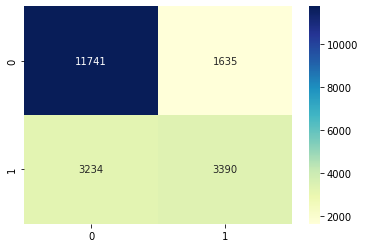

In [ ]:
stacking_clf = StackingClassifier(estimators=[('cat', cat_clf),('rnd', rnd_clf), ('lgbm', lgbm_clf), ('xgb', xgb_clf),  ('dtc', dtc_clf),  ('ada', ada_clf), ('gbc', gbc_clf), ('bag', bag_clf), ('ext', ext_clf), ('knn', knn_clf), ('lgbmstack', stacking_lgbm_clf)], final_estimator = LGBMClassifier())
stacking_clf.fit(X_train, y_train)
y_pred_stack = stacking_clf.predict(X_valid)

# ensemble(stacking) 성능 확인
get_clf_eval(y_valid, y_pred_stack)

# Submission

In [ ]:
# folder = '/content/drive/MyDrive/Colab Notebooks/ML study/day27 220126'

# 제출 양식 다운로드
submit = pd.read_csv(os.path.join(folder, 'sample_submission.csv'))

# prediction 수행
df_test = pd.read_csv(os.path.join(folder, 'test.csv'))
submit['answer'] = stacking_clf.predict(df_test.drop(columns=['ID']))

# 제출 파일 저장
submit.to_csv(os.path.join(folder, 'prediction.csv'), index=False)